**script purpose**: Visualization of extreme days and events. Continuation of EMA workbench (WF_FF_EMA_Workbench_future/obs.py): visualization of the outputs in (ema_case_Basel_HDNs). setup 3: 4080 experiments: 136 scenarios & 30 policies.


**modifications required**: commented with "MODIFY"

**codeauthor**: initially written and composed by Dr. Seyed Saeid Ashraf Vaghefi
**adapted for Master's thesis by**: Fabian Weibel (2022)
**adapted for publication by**: Fiona Federer (2025)

#### *Importing libraries*

In [1]:
import os
import os.path
import random
from operator import add
from datetime import datetime, date, timedelta
import csv as csv

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

import shutil
import ema_workbench
import time

from scipy.integrate import simps
from numpy import trapz
from decimal import Decimal, ROUND_DOWN, ROUND_UP

#### *Setting up the display extent*

In [2]:
pd.set_option('display.max_columns',69)
pd.set_option('display.max_rows',119)

In [355]:
# Define the study area to be analyzed: uncomment either the Basel or Zurich code block (MODIFY)'''

# Basel
# station = 'Basel-Binningen' # name used for plots
# city = 'Basel' # name used for directories

# Zurich
station = 'Zurich-Fluntern' # name used for plots
city = 'Zurich' # name used for directories

## 1. XLRM Framework

#### Loading the outputs

In this section using the load_results class of ema_workbench we load the saved results of python experiments (.tar.gz)

In [260]:
from ema_workbench import load_results, ema_logging
from ema_workbench.analysis.pairs_plotting import (pairs_lines, pairs_scatter,
                                                   pairs_density)
ema_logging.log_to_stderr(level=ema_logging.DEFAULT_LEVEL)

# Define the study area to be analyzed: uncomment either the Basel or Zurich code block (MODIFY)'''
# load the data for CH2018 Basel
# rootOut = r'/Users/erdtiger/Library/CloudStorage/OneDrive-UniversitätZürichUZH/Studium/EClim/Publication_Thesis_fweibel/ema_case_Basel_HDNs/case2_Basel/setup3_bernard_136_30/26_30_bernard' 
# out_zip_file_name = '20250301_runs.tar.gz' 

# load the data for CH2018 Zurich
rootOut = r'/Users/erdtiger/Library/CloudStorage/OneDrive-UniversitätZürichUZH/Studium/EClim/Publication_Thesis_fweibel/ema_case_Basel_HDNs/case2_Zurich/setup3_bernard_136_30/26_30_bernard' 
out_zip_file_name = '20250301_runs.tar.gz' 

fh = os.path.join(rootOut, out_zip_file_name)
experiments, outcomes = load_results(fh)

[MainProcess/INFO] results loaded successfully from /Users/erdtiger/Library/CloudStorage/OneDrive-UniversitätZürichUZH/Studium/EClim/Publication_Thesis_fweibel/ema_case_Basel_HDNs/case2_Zurich/setup3_bernard_136_30/26_30_bernard/20250301_runs.tar.gz


Check and see if data has been loaded properly or not?


In total 19 parameters:

- 7 variables:
Xfactor1, xClimateModel, xRCP, x7Wbgtthreshold, scenario, policy, model

- 11 outcomes: 
'S_Ave_HotDay','GCM_RCM','S_Ave_Length','S_Ave_StartEvent','S_Ave_EndEvent','S_Ave_numEvent','S_HotDay','S_Length','S_StartEvent','S_EndEvent','S_numEvent'

Explanations:
- S_Ave_HotDay: Seasonal average (1981-2100) of days with Tmax and Tmin extreme events  (conditions?) 
- GCM_RCM: The Climate model which has been used (Should not be presented in the outcomes)
- S_Ave_Length :
- S_Ave_StartEvent:
- S_Ave_EndEvent:
- S_Ave_numEvent:  
- S_HotDay: Seasonal (1981-2100) number of days with Tmax and Tmin extreme events
- S_Length:
- S_StartEvent: 
- S_EndEvent:
- S_numEvent:

In [261]:
print(experiments.shape)
print(list(experiments.keys()))
print(list(outcomes.keys()))

(4080, 7)
['Xfactor1', 'xClimateModel', 'xRCP', 'x7Wbgtthreshold', 'scenario', 'policy', 'model']
['S_Ave_HotDay', 'GCM_RCM', 'S_Ave_Length', 'S_Ave_StartEvent', 'S_Ave_EndEvent', 'S_Ave_numEvent', 'S_HotDay', 'S_Length', 'S_StartEvent', 'S_EndEvent', 'S_numEvent']


In [262]:
# load the data for observations. uncomment either the Basel or Zurich code block (MODIFY)'''

rootOut_obs = r'/Users/erdtiger/Library/CloudStorage/OneDrive-UniversitätZürichUZH/Studium/EClim/Publication_Thesis_fweibel/ema_case_Basel_HDNs/case2_Basel_obs/setup3_bernard_136_30/26_30_bernard'
out_zip_file_name_obs = '20250301_runs.tar.gz'

fh_obs = os.path.join(rootOut_obs, out_zip_file_name_obs)
experiments_obs, outcomes_obs = load_results(fh_obs)

[MainProcess/INFO] results loaded successfully from /Users/erdtiger/Library/CloudStorage/OneDrive-UniversitätZürichUZH/Studium/EClim/Publication_Thesis_fweibel/ema_case_Basel_HDNs/case2_Basel_obs/setup3_bernard_136_30/26_30_bernard/20250301_runs.tar.gz


#### Moving the outputs to the folder of results (assign the address of outputs folders)

In [263]:
# CH2018 
import tarfile

rootVisualization = rootOut
with tarfile.open(os.path.join(rootVisualization, out_zip_file_name),"r") as zip_ref:
    extract_folder = os.path.join(rootVisualization, out_zip_file_name[:-7])
    zip_ref.extractall(extract_folder)
    
	# rename .cls files to .csv after extraction (reason for .cls = MacOS)
    for file in os.listdir(extract_folder):
        if file.endswith(".cls"):
            os.rename(
                os.path.join(extract_folder, file),
                os.path.join(extract_folder, file[:-4] + ".csv")
            )

# We have five types of outputs
outDaily = os.path.join(rootVisualization, 'Outputs_py')

#M1
outSeasonTippingPoint = os.path.join(rootVisualization, 'outSeason')

outSeason_Length = os.path.join(rootVisualization, 'outSeason_length')
outSeason_StartEvents = os.path.join(rootVisualization, 'outSeason_StartEvents')
outSeason_EndEvents = os.path.join(rootVisualization, 'outSeason_EndEvents')

#M2
outSeason_NumEvents = os.path.join(rootVisualization, 'outSeason_NumEvents')
outSeason_Ave_EndEvents = os.path.join(rootVisualization, 'outSeason_Ave_EndEvents')

#M3
outSeason_Ave_LenEvents = os.path.join(rootVisualization, 'outSeason_Ave_LenEvents')

outSeason_Ave_StartEvents = os.path.join(rootVisualization, 'outSeason_Ave_StartEvents')

out_ema = os.path.join(rootVisualization, out_zip_file_name[:-7])

/var/folders/kt/dyrm35697l54p9ztqp7kv6cr0000gn/T/ipykernel_216/1534167151.py:7: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  zip_ref.extractall(extract_folder)


In [264]:
# CH2018 (EMA outputs)
df4_ema_experiment = pd.read_csv(os.path.join(out_ema, 'experiments.csv'))

#M1
df4_ema_y0 = pd.read_csv(os.path.join(out_ema, 'S_Ave_HotDay.csv'), header=None)
df4_ema_y0.columns = ["Yout0_S_Ave_HotDay"]

df4_ema_y1 = pd.read_csv(os.path.join(out_ema, 'GCM_RCM.csv'), header=None)
df4_ema_y1.columns = ["Yout1_GCM_RCM"]

#M3
df4_ema_y2 = pd.read_csv(os.path.join(out_ema, 'S_Ave_Length.csv'), header=None)
df4_ema_y2.columns = ["Yout2_Ave_Length"]

df4_ema_y3 = pd.read_csv(os.path.join(out_ema, 'S_Ave_StartEvent.csv'), header=None)
df4_ema_y3.columns = ["Yout3_Ave_StartEvent"]

df4_ema_y4 = pd.read_csv(os.path.join(out_ema, 'S_Ave_EndEvent.csv'), header=None)
df4_ema_y4.columns = ["Yout4_Ave_EndEvent"]

#M2
df4_ema_y5 = pd.read_csv(os.path.join(out_ema, 'S_Ave_numEvent.csv'), header=None)
df4_ema_y5.columns = ["Yout5_S_Ave_numEvent"]

In [265]:
# Observed (our outputs)
rootVisualization_obs = rootOut_obs

with tarfile.open(os.path.join(rootVisualization_obs, out_zip_file_name_obs), "r") as zip_ref_obs:
    extract_folder_obs = os.path.join(rootVisualization_obs, out_zip_file_name_obs[:-7])
    zip_ref_obs.extractall(extract_folder_obs)

    # Rename .cls files to .csv immediately after extraction
    for file in os.listdir(extract_folder_obs):
        if file.endswith(".cls"):
            os.rename(
                os.path.join(extract_folder_obs, file),
                os.path.join(extract_folder_obs, file[:-4] + ".csv")
            )
    	

# We have five types of outputs
outDaily_obs = os.path.join(rootVisualization_obs, 'Outputs_py')
outSeasonTippingPoint_obs = os.path.join(rootVisualization_obs, 'outSeason')
outSeason_Length_obs = os.path.join(rootVisualization_obs, 'outSeason_length')
outSeason_StartEvents_obs = os.path.join(rootVisualization_obs, 'outSeason_StartEvents')
outSeason_EndEvents_obs = os.path.join(rootVisualization_obs, 'outSeason_EndEvents')
outSeason_NumEvents_obs = os.path.join(rootVisualization_obs, 'outSeason_NumEvents')

outSeason_Ave_EndEvents_obs = os.path.join(rootVisualization_obs, 'outSeason_Ave_EndEvents')
outSeason_Ave_LenEvents_obs = os.path.join(rootVisualization_obs, 'outSeason_Ave_LenEvents')
outSeason_Ave_StartEvents_obs = os.path.join(rootVisualization_obs, 'outSeason_Ave_StartEvents')

out_ema_obs = os.path.join(rootVisualization_obs, out_zip_file_name_obs[:-7])

/var/folders/kt/dyrm35697l54p9ztqp7kv6cr0000gn/T/ipykernel_216/751403721.py:6: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  zip_ref_obs.extractall(extract_folder_obs)


In [266]:
# Observed (EMA outputs)
df4_ema_experiment_obs = pd.read_csv(os.path.join(out_ema_obs, 'experiments.csv'))

df4_ema_y0_obs = pd.read_csv(os.path.join(out_ema_obs, 'S_Ave_HotDay.csv'), header=None)
df4_ema_y0_obs.columns = ["Yout0_S_Ave_HotDay"]

df4_ema_y1_obs = pd.read_csv(os.path.join(out_ema_obs, 'GCM_RCM.csv'), header=None)
df4_ema_y1_obs.columns = ["Yout1_GCM_RCM"]

df4_ema_y2_obs = pd.read_csv(os.path.join(out_ema_obs, 'S_Ave_Length.csv'), header=None)
df4_ema_y2_obs.columns = ["Yout2_Ave_Length"]

df4_ema_y3_obs = pd.read_csv(os.path.join(out_ema_obs, 'S_Ave_StartEvent.csv'), header=None)
df4_ema_y3_obs.columns = ["Yout3_Ave_StartEvent"]

df4_ema_y4_obs = pd.read_csv(os.path.join(out_ema_obs, 'S_Ave_EndEvent.csv'), header=None)
df4_ema_y4_obs.columns = ["Yout4_Ave_EndEvent"]

df4_ema_y5_obs = pd.read_csv(os.path.join(out_ema_obs, 'S_Ave_numEvent.csv'), header=None)
df4_ema_y5_obs.columns = ["Yout5_S_Ave_numEvent"]

#### Make a database from the outputs of ema framework by concatinating the every output and experiments table

In [267]:
# CH2018
df_final_ema = pd.concat((df4_ema_experiment, df4_ema_y0, df4_ema_y1, df4_ema_y2, df4_ema_y3, df4_ema_y4, df4_ema_y5), axis = 1)
df_final_ema.head(10)

df_final_ema.to_csv(os.path.join(rootVisualization, 'df_final_ema.csv'), index = False)

In [268]:
# CH2018 Information
df_final_ema.info()
df_final_ema.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4080 entries, 0 to 4079
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Xfactor1              4080 non-null   float64
 1   xClimateModel         4080 non-null   float64
 2   xRCP                  4080 non-null   float64
 3   x7Wbgtthreshold       4080 non-null   float64
 4   scenario              4080 non-null   int64  
 5   policy                4080 non-null   int64  
 6   model                 4080 non-null   object 
 7   Yout0_S_Ave_HotDay    4080 non-null   float64
 8   Yout1_GCM_RCM         4080 non-null   int64  
 9   Yout2_Ave_Length      4080 non-null   float64
 10  Yout3_Ave_StartEvent  4080 non-null   float64
 11  Yout4_Ave_EndEvent    4080 non-null   float64
 12  Yout5_S_Ave_numEvent  4080 non-null   float64
dtypes: float64(9), int64(3), object(1)
memory usage: 414.5+ KB


,Xfactor1,xClimateModel,xRCP,x7Wbgtthreshold,scenario,policy,Yout0_S_Ave_HotDay,Yout1_GCM_RCM,Yout2_Ave_Length,Yout3_Ave_StartEvent,Yout4_Ave_EndEvent,Yout5_S_Ave_numEvent
count,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000
mean,1.999895,0.500188,2.000219,27.995573,97.500000,14.500000,6.828922,17.852941,1.457282,141.707294,143.164576,2.854533
std,0.859579,0.288719,0.858940,1.164753,39.263569,8.656502,5.363426,13.287805,0.663951,45.685244,46.300304,1.868941
min,0.520316,0.005989,0.514809,26.069663,30.000000,0.000000,0.134454,0.000000,0.105042,20.983193,21.088235,0.126050
25%,1.267214,0.250266,1.262040,27.014704,63.750000,7.000000,2.462185,6.000000,0.956403,111.230292,112.280141,1.344538
50%,2.000066,0.499893,1.995939,27.997547,97.500000,14.500000,5.621849,16.000000,1.492265,150.779342,152.395257,2.563025
75%,2.733271,0.745210,2.738354,29.033586,131.250000,22.000000,9.924370,28.250000,1.963357,180.544748,182.463738,4.058824
max,3.484645,0.999768,3.474483,29.896920,165.000000,29.000000,28.537815,46.000000,3.351003,203.970143,206.859673,9.605042


In [269]:
# Taking the values and storing in separate variables (CH2018)
xRandomness = df_final_ema['Xfactor1'].values
xClimateModel = df_final_ema['xClimateModel'].values
xRCP = df_final_ema['xRCP'].values
x7Wbgtthreshold = df_final_ema['x7Wbgtthreshold'].values ###Fabian

#M1
y0 = df_final_ema['Yout0_S_Ave_HotDay'].values
y1 = df_final_ema['Yout1_GCM_RCM'].values

#M3
y2 = df_final_ema['Yout2_Ave_Length'].values
y3 = df_final_ema['Yout3_Ave_StartEvent'].values
y4 = df_final_ema['Yout4_Ave_EndEvent'].values

#M2
y5 = df_final_ema['Yout5_S_Ave_numEvent'].values

In [270]:
# Observed
df_final_ema_obs = pd.concat((df4_ema_experiment_obs, df4_ema_y0_obs, df4_ema_y1_obs, df4_ema_y2_obs, df4_ema_y3_obs, df4_ema_y4_obs, df4_ema_y5_obs), axis = 1)
df_final_ema_obs.head(10)

df_final_ema_obs.to_csv(os.path.join(rootVisualization_obs, 'df_final_ema_obs.csv'), index = False)

In [271]:
# Observed Information
df_final_ema_obs.info()
df_final_ema_obs.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4080 entries, 0 to 4079
Data columns (total 11 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Xfactor1              4080 non-null   float64
 1   x7Wbgtthreshold       4080 non-null   float64
 2   scenario              4080 non-null   int64  
 3   policy                4080 non-null   int64  
 4   model                 4080 non-null   object 
 5   Yout0_S_Ave_HotDay    4080 non-null   float64
 6   Yout1_GCM_RCM         4080 non-null   int64  
 7   Yout2_Ave_Length      4080 non-null   float64
 8   Yout3_Ave_StartEvent  4080 non-null   float64
 9   Yout4_Ave_EndEvent    4080 non-null   float64
 10  Yout5_S_Ave_numEvent  4080 non-null   float64
dtypes: float64(7), int64(3), object(1)
memory usage: 350.8+ KB


,Xfactor1,x7Wbgtthreshold,scenario,policy,Yout0_S_Ave_HotDay,Yout1_GCM_RCM,Yout2_Ave_Length,Yout3_Ave_StartEvent,Yout4_Ave_EndEvent,Yout5_S_Ave_numEvent
count,4080.000000,4080.000000,4080.000000,4080.000000,4080.000000,4080.0,4080.000000,4080.000000,4080.000000,4080.000000
mean,1.999908,28.005720,97.500000,14.500000,6.860000,0.0,1.543554,179.043947,180.587501,3.565000
std,0.860384,1.157391,39.263569,8.656502,4.276453,0.0,0.430786,24.220118,24.631610,1.815971
min,0.518855,26.055570,30.000000,0.000000,1.625000,0.0,0.786667,128.362500,129.166667,1.175000
25%,1.253944,27.018269,63.750000,7.000000,2.875000,0.0,1.141667,156.258333,157.400000,1.850000
50%,2.007737,28.033335,97.500000,14.500000,5.837500,0.0,1.612674,190.984802,192.644861,3.175000
75%,2.744977,29.044665,131.250000,22.000000,10.075000,0.0,1.911121,201.123998,203.042162,5.000000
max,3.482943,29.871745,165.000000,29.000000,15.700000,0.0,2.229080,203.074993,205.304073,7.075000


In [272]:
# Taking the values and storing in separate variables (observation)
xRandomness_obs = df_final_ema['Xfactor1'].values
x7Wbgtthreshold_obs = df_final_ema['x7Wbgtthreshold'].values ###Fabian
y0_obs = df_final_ema_obs['Yout0_S_Ave_HotDay'].values
y1_obs = df_final_ema_obs['Yout1_GCM_RCM'].values
y2_obs = df_final_ema_obs['Yout2_Ave_Length'].values
y3_obs = df_final_ema_obs['Yout3_Ave_StartEvent'].values
y4_obs = df_final_ema_obs['Yout4_Ave_EndEvent'].values
y5_obs = df_final_ema_obs['Yout5_S_Ave_numEvent'].values

In [273]:
filt1 = (df_final_ema['xRCP'] == 1.0)
filt2 = (df_final_ema['xRCP'] == 2.0)
filt3 = (df_final_ema['xRCP'] == 3.0)
filt_obs = (df_final_ema_obs['Yout1_GCM_RCM'] == 0) # löschen: change: bei original code 'scenario' == 0 

In [274]:
filt1 = (round(df_final_ema['xRCP']) == 1.0)
filt2 = (round(df_final_ema['xRCP']) == 2.0)
filt3 = (round(df_final_ema['xRCP']) == 3.0)

In [275]:
'''Data set number of days per year for boxplots'''
df_final_ema_f1_day = df_final_ema.loc[filt1, 'Yout0_S_Ave_HotDay']
df_final_ema_f2_day = df_final_ema.loc[filt2, 'Yout0_S_Ave_HotDay']
df_final_ema_f3_day = df_final_ema.loc[filt3, 'Yout0_S_Ave_HotDay']
df_obs_extreme_fobs_day = df_final_ema_obs.loc[filt_obs, 'Yout0_S_Ave_HotDay']

'''Means'''
print(df_final_ema_f1_day.mean())
print(df_final_ema_f2_day.mean())
print(df_final_ema_f3_day.mean())
print(df_obs_extreme_fobs_day.mean())

3.433028322440087
6.194629156010231
10.873202614379084
6.859999999999999


In [276]:
'''Data set number of events per year for boxplots'''
df_final_ema_f1 = df_final_ema.loc[filt1, 'Yout5_S_Ave_numEvent']
df_final_ema_f2 = df_final_ema.loc[filt2, 'Yout5_S_Ave_numEvent']
df_final_ema_f3 = df_final_ema.loc[filt3, 'Yout5_S_Ave_numEvent']
df_obs_extreme_fobs = df_final_ema_obs.loc[filt_obs, 'Yout5_S_Ave_numEvent']

'''Means'''
print(df_final_ema_f1.mean())
print(df_final_ema_f2.mean())
print(df_final_ema_f3.mean())
print(df_obs_extreme_fobs.mean())

1.7134889511360099
2.698343685300207
4.155238095238095
3.5650000000000004


In [277]:
'''Data set average length of events for boxplots'''
df_final_ema_f1_L = df_final_ema.loc[filt1, 'Yout2_Ave_Length']
df_final_ema_f2_L = df_final_ema.loc[filt2, 'Yout2_Ave_Length']
df_final_ema_f3_L = df_final_ema.loc[filt3, 'Yout2_Ave_Length']
df_obs_extreme_fobs_L = df_final_ema_obs.loc[filt_obs, 'Yout2_Ave_Length']

'''Means'''
print(df_final_ema_f1_L.mean())
print(df_final_ema_f2_L.mean())
print(df_final_ema_f3_L.mean())
print(df_obs_extreme_fobs_L.mean())

1.0876370015328933
1.4734238627756648
1.8104266105045819
1.543553922928923


In [278]:
df_obs_extreme_fobs.head()

0    1.65
1    1.65
2    1.65
3    1.65
4    1.65
Name: Yout5_S_Ave_numEvent, dtype: float64

In [279]:
df_final_ema_f1.head()

0    1.008403
1    0.857143
3    0.815126
5    1.008403
9    0.857143
Name: Yout5_S_Ave_numEvent, dtype: float64

In [280]:
df_final_ema_f2.head()

2     2.294118
6     2.058824
7     2.823529
12    1.647059
13    2.117647
Name: Yout5_S_Ave_numEvent, dtype: float64

In [281]:
outFolder = rootVisualization
outSeasonFolder = os.path.join(outFolder, 'outSeason')
outSeason_length_folder = os.path.join(outFolder, 'outSeason_length')
outSeason_EndEvents_folder = os.path.join(outFolder, 'outSeason_EndEvents')
outSeason_StartEvents_folder = os.path.join(outFolder, 'outSeason_StartEvents')
outSeason_NumEvents_folder = os.path.join(outFolder, 'outSeason_NumEvents')

#### 
outSeason_Ave_EndEvents_folder = os.path.join(outFolder, 'outSeason_Ave_EndEvents')
outSeason_Ave_LenEvents_folder = os.path.join(outFolder, 'outSeason_Ave_LenEvents')
outSeason_Ave_StartEvents_folder = os.path.join(outFolder, 'outSeason_Ave_StartEvents')

outFolder_obs = rootVisualization_obs
outSeasonFolder_obs = os.path.join(outFolder_obs, 'outSeason')
outSeason_length_folder_obs = os.path.join(outFolder_obs, 'outSeason_length')
outSeason_EndEvents_folder_obs = os.path.join(outFolder_obs, 'outSeason_EndEvents')
outSeason_StartEvents_folder_obs = os.path.join(outFolder_obs, 'outSeason_StartEvents')
outSeason_NumEvents_folder_obs = os.path.join(outFolder_obs, 'outSeason_NumEvents')

#### 
outSeason_Ave_EndEvents_folder_obs = os.path.join(outFolder_obs, 'outSeason_Ave_EndEvents')
outSeason_Ave_LenEvents_folder_obs = os.path.join(outFolder_obs, 'outSeason_Ave_LenEvents')
outSeason_Ave_StartEvents_folder_obs = os.path.join(outFolder_obs, 'outSeason_Ave_StartEvents')


### CH2018

In [282]:
#######

all_Files = []
for filename in os.walk(outSeasonFolder):
    all_Files = filename[2]
    
totalFiles_loc = []
for i in range(len(all_Files)):
    totalFiles_loc.append(os.path.join(outSeasonFolder, all_Files[i]))

#######
    
all_Files_len = []
for filename in os.walk(outSeason_length_folder):
    all_Files_len = filename[2]
    
totalFiles_loc_len = []
for i in range(len(all_Files_len)):
    totalFiles_loc_len.append(os.path.join(outSeason_length_folder, all_Files_len[i]))

#######

all_Files_End = []
for filename in os.walk(outSeason_EndEvents_folder):
    all_Files_End = filename[2]
    
totalFiles_loc_End = []
for i in range(len(all_Files_End)):
    totalFiles_loc_End.append(os.path.join(outSeason_EndEvents_folder, all_Files_End[i]))
    
#######

all_Files_Start = []
for filename in os.walk(outSeason_StartEvents_folder):
    all_Files_Start = filename[2]
    
totalFiles_loc_Start = []
for i in range(len(all_Files_Start)):
    totalFiles_loc_Start.append(os.path.join(outSeason_StartEvents_folder, all_Files_Start[i]))
    
#######

all_Files_Num = []
for filename in os.walk(outSeason_NumEvents_folder):
    all_Files_Num = filename[2]
    
totalFiles_loc_Num = []
for i in range(len(all_Files_Num)):
    totalFiles_loc_Num.append(os.path.join(outSeason_NumEvents_folder, all_Files_Num[i]))
    
#######

all_Files_Ave_EndEvents = []
for filename in os.walk(outSeason_Ave_EndEvents_folder):
    all_Files_Ave_EndEvents = filename[2]
    
totalFiles_loc_Ave_EndEvents = []
for i in range(len(all_Files_Ave_EndEvents)):
    totalFiles_loc_Ave_EndEvents.append(os.path.join(outSeason_Ave_EndEvents_folder, all_Files_Ave_EndEvents[i]))
    
#######

all_Files_Ave_LenEvents = []
for filename in os.walk(outSeason_Ave_LenEvents_folder):
    all_Files_Ave_LenEvents = filename[2]
    
totalFiles_loc_Ave_LenEvents = []
for i in range(len(all_Files_Ave_LenEvents)):
    totalFiles_loc_Ave_LenEvents.append(os.path.join(outSeason_Ave_LenEvents_folder, all_Files_Ave_LenEvents[i]))   

######

all_Files_Ave_StartEvents = []
for filename in os.walk(outSeason_Ave_StartEvents_folder):
    all_Files_Ave_StartEvents = filename[2]
    
totalFiles_loc_Ave_StartEvents = []
for i in range(len(all_Files_Ave_StartEvents)):
    totalFiles_loc_Ave_StartEvents.append(os.path.join(outSeason_Ave_StartEvents_folder, all_Files_Ave_StartEvents[i]))  

### Observed

In [283]:
#######

all_Files_obs = []
for filename in os.walk(outSeasonFolder_obs):
    all_Files_obs = filename[2]
    
totalFiles_loc_obs = []
for i in range(len(all_Files_obs)):
    totalFiles_loc_obs.append(os.path.join(outSeasonFolder_obs, all_Files_obs[i]))

#######
    
all_Files_len_obs = []
for filename in os.walk(outSeason_length_folder_obs):
    all_Files_len_obs = filename[2]
    
totalFiles_loc_len_obs = []
for i in range(len(all_Files_len_obs)):
    totalFiles_loc_len_obs.append(os.path.join(outSeason_length_folder_obs, all_Files_len_obs[i]))

#######   

all_Files_End_obs = []
for filename in os.walk(outSeason_EndEvents_folder_obs):
    all_Files_End_obs = filename[2]
    
totalFiles_loc_End_obs = []
for i in range(len(all_Files_End_obs)):
    totalFiles_loc_End_obs.append(os.path.join(outSeason_EndEvents_folder_obs, all_Files_End_obs[i]))
    
####### 

all_Files_Start_obs = []
for filename in os.walk(outSeason_StartEvents_folder_obs):
    all_Files_Start_obs = filename[2]
    
totalFiles_loc_Start_obs = []
for i in range(len(all_Files_Start_obs)):
    totalFiles_loc_Start_obs.append(os.path.join(outSeason_StartEvents_folder_obs, all_Files_Start_obs[i]))
    
#######

all_Files_Num_obs = []
for filename in os.walk(outSeason_NumEvents_folder_obs):
    all_Files_Num_obs = filename[2]
    
totalFiles_loc_Num_obs = []
for i in range(len(all_Files_Num_obs)):
    totalFiles_loc_Num_obs.append(os.path.join(outSeason_NumEvents_folder_obs, all_Files_Num_obs[i]))
    
#######

all_Files_Ave_EndEvents_obs = []
for filename in os.walk(outSeason_Ave_EndEvents_folder_obs):
    all_Files_Ave_EndEvents_obs = filename[2]
    
totalFiles_loc_Ave_EndEvents_obs = []
for i in range(len(all_Files_Ave_EndEvents_obs)):
    totalFiles_loc_Ave_EndEvents_obs.append(os.path.join(outSeason_Ave_EndEvents_folder_obs, all_Files_Ave_EndEvents_obs[i]))
    
#######

all_Files_Ave_LenEvents_obs = []
for filename in os.walk(outSeason_Ave_LenEvents_folder_obs):
    all_Files_Ave_LenEvents_obs = filename[2]
    
totalFiles_loc_Ave_LenEvents_obs = []
for i in range(len(all_Files_Ave_LenEvents_obs)):
    totalFiles_loc_Ave_LenEvents_obs.append(os.path.join(outSeason_Ave_LenEvents_folder_obs, all_Files_Ave_LenEvents_obs[i]))   

######

all_Files_Ave_StartEvents_obs = []
for filename in os.walk(outSeason_Ave_StartEvents_folder_obs):
    all_Files_Ave_StartEvents_obs = filename[2]
    
totalFiles_loc_Ave_StartEvents_obs = []
for i in range(len(all_Files_Ave_StartEvents_obs)):
    totalFiles_loc_Ave_StartEvents_obs.append(os.path.join(outSeason_Ave_StartEvents_folder_obs, all_Files_Ave_StartEvents_obs[i]))  

### Total number of outputs (csv files) in each out folder produced by our framework

In [284]:
### CH2018 

In [285]:
print(len(totalFiles_loc))
print(len(totalFiles_loc_len))
print(len(totalFiles_loc_End))
print(len(totalFiles_loc_Start))
print(len(totalFiles_loc_Num))
print(len(totalFiles_loc_Ave_EndEvents))
print(len(totalFiles_loc_Ave_LenEvents))
print(len(totalFiles_loc_Ave_StartEvents))

4080
4080
4080
4080
4080
4080
4080
4080


In [286]:
### Observed

In [287]:
print(len(totalFiles_loc_obs))
print(len(totalFiles_loc_len_obs))
print(len(totalFiles_loc_End_obs))
print(len(totalFiles_loc_Start_obs))
print(len(totalFiles_loc_Num_obs))
print(len(totalFiles_loc_Ave_EndEvents_obs))
print(len(totalFiles_loc_Ave_LenEvents_obs))
print(len(totalFiles_loc_Ave_StartEvents_obs))

4080
4080
4080
4080
4080
4080
4080
4080


### CH2018: making matrixes (time wise expensive)

In [288]:
emptyMatrixHotDays = [np.empty([1,1]) for _ in range(len(totalFiles_loc))]
    
for i in range(0, len(totalFiles_loc), 1):
    b = []
    with open(totalFiles_loc[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixHotDays[i] = np.array(b)

#####

emptyMatrixLen = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Ave_LenEvents))]
    
for i in range(0, len(totalFiles_loc_Ave_LenEvents), 1):
    b = []
    with open(totalFiles_loc_Ave_LenEvents[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixLen[i] = np.array(b)

#####

emptyMatrixEnd = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Ave_EndEvents))]
    
for i in range(0, len(totalFiles_loc_Ave_EndEvents), 1):
    b = []
    with open(totalFiles_loc_Ave_EndEvents[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixEnd[i] = np.array(b)
    
#####

emptyMatrixStart = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Ave_StartEvents))]
    
for i in range(0, len(totalFiles_loc_Ave_StartEvents), 1):
    b = []
    with open(totalFiles_loc_Ave_StartEvents[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixStart[i] = np.array(b)

emptyMatrixNum = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Num))]
    
for i in range(0, len(totalFiles_loc_Num), 1):
    b = []
    with open(totalFiles_loc_Num[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixNum[i] = np.array(b)

### Observed: making matrixes

In [289]:
emptyMatrixHotDays_obs = [np.empty([1,1]) for _ in range(len(totalFiles_loc_obs))]
    
for i in range(0, len(totalFiles_loc_obs), 1):
    b = []
    with open(totalFiles_loc_obs[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixHotDays_obs[i] = np.array(b)

#####

emptyMatrixLen_obs = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Ave_LenEvents_obs))]
    
for i in range(0, len(totalFiles_loc_Ave_LenEvents_obs), 1):
    b = []
    with open(totalFiles_loc_Ave_LenEvents_obs[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixLen_obs[i] = np.array(b)

#####

emptyMatrixEnd_obs = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Ave_EndEvents_obs))]
    
for i in range(0, len(totalFiles_loc_Ave_EndEvents_obs), 1):
    b = []
    with open(totalFiles_loc_Ave_EndEvents_obs[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixEnd_obs[i] = np.array(b)
    
#####

emptyMatrixStart_obs = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Ave_StartEvents_obs))]
    
for i in range(0, len(totalFiles_loc_Ave_StartEvents_obs), 1):
    b = []
    with open(totalFiles_loc_Ave_StartEvents_obs[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixStart_obs[i] = np.array(b)
    
emptyMatrixNum_obs = [np.empty([1,1]) for _ in range(len(totalFiles_loc_Num_obs))]
    
for i in range(0, len(totalFiles_loc_Num_obs), 1):
    b = []
    with open(totalFiles_loc_Num_obs[i], 'r') as file:
        outputReaderlines = file.readlines()
        for j in range (len(outputReaderlines)):
            b.append(outputReaderlines[j].replace('\n','').split(','))
    
    emptyMatrixNum_obs[i] = np.array(b)

### CH2018 and Observed () number simulation years and experiments

In [290]:
len(totalFiles_loc)

4080

In [291]:
len(emptyMatrixHotDays_obs)

4080

In [292]:
# Check that all arrays have the shape (120, 2) and print any mismatch
for i, arr in enumerate(emptyMatrixLen):
    if arr.shape != (120, 2):
        print(f"Shape mismatch at index {i}:")
        print(f"Array {i} shape: {arr.shape}")
        print(f"Array {i}: {arr}")
        break  # Stop after printing the first mismatch
else:
    print("All arrays have the correct shape (120, 2).")

All arrays have the correct shape (120, 2).


In [293]:
emptyMatrixHotDays_obs[1].shape

(41, 2)

### Stack / modify matrixes CH2018 and observed

In [294]:
matrix_HotDays = np.stack(emptyMatrixHotDays[:len(totalFiles_loc)], axis=0)
matrix_Len = np.stack(emptyMatrixLen[:len(totalFiles_loc_Ave_LenEvents)], axis=0)
matrix_End = np.stack(emptyMatrixEnd[:len(totalFiles_loc_Ave_EndEvents)], axis=0)
matrix_Start = np.stack(emptyMatrixStart[:len(totalFiles_loc_Ave_StartEvents)], axis=0)
matrix_Num = np.stack(emptyMatrixNum[:len(totalFiles_loc_Num)], axis=0)

In [295]:
print(matrix_HotDays.shape)
print(matrix_Len.shape)
print(matrix_End.shape)
print(matrix_Start.shape)
print(matrix_Num.shape)

(4080, 120, 2)
(4080, 120, 2)
(4080, 120, 2)
(4080, 120, 2)
(4080, 120, 2)


In [296]:
matrix_HotDays_obs = np.stack(emptyMatrixHotDays_obs[:len(totalFiles_loc_obs)], axis=0)
matrix_Len_obs = np.stack(emptyMatrixLen_obs[:len(totalFiles_loc_Ave_LenEvents_obs)], axis=0)
matrix_End_obs = np.stack(emptyMatrixEnd_obs[:len(totalFiles_loc_Ave_EndEvents_obs)], axis=0)
matrix_Start_obs = np.stack(emptyMatrixStart_obs[:len(totalFiles_loc_Ave_StartEvents_obs)], axis=0)
matrix_Num_obs = np.stack(emptyMatrixNum_obs[:len(totalFiles_loc_Num_obs)], axis=0)

In [297]:
print(matrix_HotDays_obs.shape)
print(matrix_Len_obs.shape)
print(matrix_End_obs.shape)
print(matrix_Start_obs.shape)
print(matrix_Num_obs.shape)

(4080, 41, 2)
(4080, 41, 2)
(4080, 41, 2)
(4080, 41, 2)
(4080, 41, 2)


In [298]:
print(matrix_HotDays_obs)

[[['Season' 'is_Wbgt_exEveBAS_Obs_RCP26']
  ['1981' '0.0']
  ['1982' '2.0']
  ...
  ['2018' '14.0']
  ['2019' '12.0']
  ['2020' '10.0']]

 [['Season' 'is_Wbgt_exEveBAS_Obs_RCP26']
  ['1981' '0.0']
  ['1982' '0.0']
  ...
  ['2018' '1.0']
  ['2019' '8.0']
  ['2020' '1.0']]

 [['Season' 'is_Wbgt_exEveBAS_Obs_RCP26']
  ['1981' '0.0']
  ['1982' '0.0']
  ...
  ['2018' '1.0']
  ['2019' '8.0']
  ['2020' '1.0']]

 ...

 [['Season' 'is_Wbgt_exEveBAS_Obs_RCP26']
  ['1981' '0.0']
  ['1982' '0.0']
  ...
  ['2018' '3.0']
  ['2019' '11.0']
  ['2020' '2.0']]

 [['Season' 'is_Wbgt_exEveBAS_Obs_RCP26']
  ['1981' '0.0']
  ['1982' '0.0']
  ...
  ['2018' '3.0']
  ['2019' '11.0']
  ['2020' '2.0']]

 [['Season' 'is_Wbgt_exEveBAS_Obs_RCP26']
  ['1981' '0.0']
  ['1982' '0.0']
  ...
  ['2018' '8.0']
  ['2019' '11.0']
  ['2020' '5.0']]]


In [299]:
### Check the header of outputs CH2018

In [300]:
print(emptyMatrixHotDays[1][0,1])
print(emptyMatrixLen[1][0,1])
print(emptyMatrixEnd[1][0,1])
print(emptyMatrixHotDays[1][0,1])
print(emptyMatrixStart[1][0,1])

is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45
is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45
is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45
is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45
is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45


In [301]:
### Check the header of outputs observed

In [302]:
print(emptyMatrixHotDays_obs[1][0,1])
print(emptyMatrixLen_obs[1][0,1])
print(emptyMatrixEnd_obs[1][0,1])
print(emptyMatrixHotDays_obs[1][0,1])
print(emptyMatrixStart_obs[1][0,1])

is_Wbgt_exEveBAS_Obs_RCP26
is_Wbgt_exEveBAS_Obs_RCP26
is_Wbgt_exEveBAS_Obs_RCP26
is_Wbgt_exEveBAS_Obs_RCP26
is_Wbgt_exEveBAS_Obs_RCP26


In [303]:
### Split the matrix CH2018 to Rcp2.6, Rcp4.5, and Rcp8.5 (needs RAM)

In [304]:
matrix_HotDays26 = np.stack(
    [arr for arr in emptyMatrixHotDays[:len(totalFiles_loc)] 
     if 'RCP26' in arr[0, 1] or '_26_' in arr[0, 1]], 
    axis=0)
matrix_HotDays45 = np.stack(
    [arr for arr in emptyMatrixHotDays[:len(totalFiles_loc)] 
     if 'RCP45' in arr[0, 1] or '_45_' in arr[0, 1]], 
    axis=0)
matrix_HotDays85 = np.stack(
    [arr for arr in emptyMatrixHotDays[:len(totalFiles_loc)] 
     if 'RCP85' in arr[0, 1] or '_85_' in arr[0, 1]], 
    axis=0)
matrix_Len26 = np.stack(
    [arr for arr in emptyMatrixLen[:len(totalFiles_loc_Ave_LenEvents)] 
     if 'RCP26' in arr[0, 1] or '_26_' in arr[0, 1]], 
    axis=0)
matrix_Len45 = np.stack(
    [arr for arr in emptyMatrixLen[:len(totalFiles_loc_Ave_LenEvents)] 
     if 'RCP45' in arr[0, 1] or '_45_' in arr[0, 1]], 
    axis=0)
matrix_Len85 = np.stack(
    [arr for arr in emptyMatrixLen[:len(totalFiles_loc_Ave_LenEvents)] 
     if 'RCP85' in arr[0, 1] or '_85_' in arr[0, 1]], 
    axis=0)
matrix_End26 = np.stack(
    [arr for arr in emptyMatrixEnd[:len(totalFiles_loc_Ave_EndEvents)] 
     if 'RCP26' in arr[0, 1] or '_26_' in arr[0, 1]], 
    axis=0)
matrix_End45 = np.stack(
    [arr for arr in emptyMatrixEnd[:len(totalFiles_loc_Ave_EndEvents)] 
     if 'RCP45' in arr[0, 1] or '_45_' in arr[0, 1]], 
    axis=0)
matrix_End85 = np.stack(
    [arr for arr in emptyMatrixEnd[:len(totalFiles_loc_Ave_EndEvents)] 
     if 'RCP85' in arr[0, 1] or '_85_' in arr[0, 1]], 
    axis=0)
matrix_Start26 = np.stack(
    [arr for arr in emptyMatrixStart[:len(totalFiles_loc_Ave_StartEvents)] 
     if 'RCP26' in arr[0, 1] or '_26_' in arr[0, 1]], 
    axis=0)
matrix_Start45 = np.stack(
    [arr for arr in emptyMatrixStart[:len(totalFiles_loc_Ave_StartEvents)] 
     if 'RCP45' in arr[0, 1] or '_45_' in arr[0, 1]], 
    axis=0)
matrix_Start85 = np.stack(
    [arr for arr in emptyMatrixStart[:len(totalFiles_loc_Ave_StartEvents)] 
     if 'RCP85' in arr[0, 1] or '_85_' in arr[0, 1]], 
    axis=0)
matrix_Num26 = np.stack(
    [arr for arr in emptyMatrixNum[:len(totalFiles_loc_Num)] 
     if 'RCP26' in arr[0, 1] or '_26_' in arr[0, 1]], 
    axis=0)
matrix_Num45 = np.stack(
    [arr for arr in emptyMatrixNum[:len(totalFiles_loc_Num)] 
     if 'RCP45' in arr[0, 1] or '_45_' in arr[0, 1]], 
    axis=0)
matrix_Num85 = np.stack(
    [arr for arr in emptyMatrixNum[:len(totalFiles_loc_Num)] 
     if 'RCP85' in arr[0, 1] or '_85_' in arr[0, 1]], 
    axis=0)

In [305]:
### Matrices information
print("#########")
print(type(matrix_HotDays))
print(matrix_HotDays.ndim)
print(len(matrix_HotDays))
print(matrix_HotDays.size)
print(matrix_HotDays.dtype)
print(matrix_HotDays.dtype.name)

print("#########")
print(matrix_Num26.shape)
print(matrix_Num45.shape)
print(matrix_Num85.shape)
print(len(matrix_Num26) + len(matrix_Num45) + len(matrix_Num85))

print("#########")
print(matrix_Start26.shape)
print(matrix_Start45.shape)
print(matrix_Start85.shape)
print(len(matrix_Start26) + len(matrix_Start45) + len(matrix_Start85))

print("#########")
print(matrix_End26.shape)
print(matrix_End45.shape)
print(matrix_End85.shape)
print(len(matrix_End26) + len(matrix_End45) + len(matrix_End85))

print("#########")
print(matrix_Len26.shape)
print(matrix_Len45.shape)
print(matrix_Len85.shape)
print(len(matrix_Len26) + len(matrix_Len45) + len(matrix_Len85))

print("#########")
print(type(matrix_HotDays_obs))
print(matrix_HotDays_obs.ndim)
print(len(matrix_HotDays_obs))
print(matrix_HotDays_obs.size)
print(matrix_HotDays_obs.dtype)
print(matrix_HotDays_obs.dtype.name)


#########
<class 'numpy.ndarray'>
3
4080
979200
<U56
str1792
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
<class 'numpy.ndarray'>
3
4080
334560
<U26
str832


In [306]:
print(matrix_HotDays[2, 1:, 1:2].shape)
print(matrix_Len[2, 1:, 1:2].shape)
print(matrix_End[2, 1:, 1:2].shape)
print(matrix_Start[2, 1:, 1:2].shape)
print(matrix_Num[2, 1:, 1:2].shape)

print("#########")

print(matrix_HotDays_obs[2, 1:, 1:2].shape)
print(matrix_Len_obs[2, 1:, 1:2].shape)
print(matrix_End_obs[2, 1:, 1:2].shape)
print(matrix_Start_obs[2, 1:, 1:2].shape)
print(matrix_Num_obs[2, 1:, 1:2].shape)

(119, 1)
(119, 1)
(119, 1)
(119, 1)
(119, 1)
#########
(40, 1)
(40, 1)
(40, 1)
(40, 1)
(40, 1)


### Export

In [307]:
# Export matrices to csv
filename_NED_26 = f'time_periods_NED_RCP26_{city}.csv'
filename_NED_45 = f'time_periods_NED_RCP45_{city}.csv'
filename_NED_85 = f'time_periods_NED_RCP85_{city}.csv'
filename_NEE_26 = f'time_periods_NEE_RCP26_{city}.csv'
filename_NEE_45 = f'time_periods_NEE_RCP45_{city}.csv'
filename_NEE_85 = f'time_periods_NEE_RCP85_{city}.csv'
filename_LEE_26 = f'time_periods_LEE_RCP26_{city}.csv'
filename_LEE_45 = f'time_periods_LEE_RCP45_{city}.csv'
filename_LEE_85 = f'time_periods_LEE_RCP85_{city}.csv'


with open(os.path.join(rootOut, filename_NED_26),"w+") as my_csv_26_NED:
    newarray_26_NED = csv.writer(my_csv_26_NED,delimiter=',')
    newarray_26_NED.writerows(matrix_HotDays26)
    
with open(os.path.join(rootOut, filename_NED_45),"w+") as my_csv_45_NED:
    newarray_45_NED = csv.writer(my_csv_45_NED,delimiter=',')
    newarray_45_NED.writerows(matrix_HotDays45)

with open(os.path.join(rootOut, filename_NED_85),"w+") as my_csv_85_NED:
    newarray_85_NED = csv.writer(my_csv_85_NED,delimiter=',')
    newarray_85_NED.writerows(matrix_HotDays85)

with open(os.path.join(rootOut, filename_NEE_26),"w+") as my_csv_26:
    newarray_26 = csv.writer(my_csv_26,delimiter=',')
    newarray_26.writerows(matrix_Num26)

with open(os.path.join(rootOut, filename_NEE_45),"w+") as my_csv_45:
    newarray_45 = csv.writer(my_csv_45,delimiter=',')
    newarray_45.writerows(matrix_Num45)

with open(os.path.join(rootOut, filename_NEE_85),"w+") as my_csv_85:
    newarray_85 = csv.writer(my_csv_85,delimiter=',')
    newarray_85.writerows(matrix_Num85)

with open(os.path.join(rootOut, filename_LEE_26),"w+") as my_csv_26_LEE:
    newarray_26_LEE = csv.writer(my_csv_26_LEE,delimiter=',')
    newarray_26_LEE.writerows(matrix_Len26)

with open(os.path.join(rootOut, filename_LEE_45),"w+") as my_csv_45_LEE:
    newarray_45_LEE = csv.writer(my_csv_45_LEE,delimiter=',')
    newarray_45_LEE.writerows(matrix_Len45)

with open(os.path.join(rootOut, filename_LEE_85),"w+") as my_csv_85_LEE:
    newarray_85_LEE = csv.writer(my_csv_85_LEE,delimiter=',')
    newarray_85_LEE.writerows(matrix_Len85)


### Calculate quantiles

In [308]:
# Calculate the quantiles for each year of simulation (1981-2100)
q10_years = np.quantile(matrix_HotDays[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years = np.quantile(matrix_HotDays[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years = np.quantile(matrix_HotDays[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years = np.quantile(matrix_HotDays[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years = np.quantile(matrix_HotDays[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Len = np.quantile(matrix_Len[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Len = np.quantile(matrix_Len[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Len = np.quantile(matrix_Len[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Len = np.quantile(matrix_Len[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Len = np.quantile(matrix_Len[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_End = np.quantile(matrix_End[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_End = np.quantile(matrix_End[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_End = np.quantile(matrix_End[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_End = np.quantile(matrix_End[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_End = np.quantile(matrix_End[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Start = np.quantile(matrix_Start[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Start = np.quantile(matrix_Start[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Start = np.quantile(matrix_Start[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Start = np.quantile(matrix_Start[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Start = np.quantile(matrix_Start[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Num = np.quantile(matrix_Num[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Num = np.quantile(matrix_Num[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Num = np.quantile(matrix_Num[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Num = np.quantile(matrix_Num[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Num = np.quantile(matrix_Num[:, 1:, 1:2].astype(float), 0.9, axis=0)

print("#########")

q10_years_obs = np.quantile(matrix_HotDays_obs[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_obs = np.quantile(matrix_HotDays_obs[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_obs = np.quantile(matrix_HotDays_obs[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_obs = np.quantile(matrix_HotDays_obs[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_obs = np.quantile(matrix_HotDays_obs[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Len_obs = np.quantile(matrix_Len_obs[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Len_obs = np.quantile(matrix_Len_obs[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Len_obs = np.quantile(matrix_Len_obs[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Len_obs = np.quantile(matrix_Len_obs[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Len_obs = np.quantile(matrix_Len_obs[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_End_obs = np.quantile(matrix_End_obs[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_End_obs = np.quantile(matrix_End_obs[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_End_obs = np.quantile(matrix_End_obs[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_End_obs = np.quantile(matrix_End_obs[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_End_obs = np.quantile(matrix_End_obs[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Start_obs = np.quantile(matrix_Start_obs[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Start_obs = np.quantile(matrix_Start_obs[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Start_obs = np.quantile(matrix_Start_obs[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Start_obs = np.quantile(matrix_Start_obs[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Start_obs = np.quantile(matrix_Start_obs[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Num_obs = np.quantile(matrix_Num_obs[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Num_obs = np.quantile(matrix_Num_obs[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Num_obs = np.quantile(matrix_Num_obs[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Num_obs = np.quantile(matrix_Num_obs[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Num_obs = np.quantile(matrix_Num_obs[:, 1:, 1:2].astype(float), 0.9, axis=0)

#########


In [309]:
q50_years_Num_obs

array([[0. ],
       [1. ],
       [3. ],
       [3. ],
       [3. ],
       [1.5],
       [1. ],
       [2. ],
       [2. ],
       [2.5],
       [3. ],
       [6. ],
       [2. ],
       [5. ],
       [2. ],
       [1. ],
       [0. ],
       [4. ],
       [1. ],
       [2. ],
       [2. ],
       [1. ],
       [9. ],
       [3. ],
       [3. ],
       [6. ],
       [2. ],
       [1. ],
       [2.5],
       [5. ],
       [6. ],
       [4.5],
       [5. ],
       [2. ],
       [8.5],
       [3. ],
       [5. ],
       [4. ],
       [4. ],
       [3. ]])

In [310]:
q50_years_Num_obs

array([[0. ],
       [1. ],
       [3. ],
       [3. ],
       [3. ],
       [1.5],
       [1. ],
       [2. ],
       [2. ],
       [2.5],
       [3. ],
       [6. ],
       [2. ],
       [5. ],
       [2. ],
       [1. ],
       [0. ],
       [4. ],
       [1. ],
       [2. ],
       [2. ],
       [1. ],
       [9. ],
       [3. ],
       [3. ],
       [6. ],
       [2. ],
       [1. ],
       [2.5],
       [5. ],
       [6. ],
       [4.5],
       [5. ],
       [2. ],
       [8.5],
       [3. ],
       [5. ],
       [4. ],
       [4. ],
       [3. ]])

In [311]:
### CH2018

In [312]:
print(q10_years[0])
print(q25_years[0])
print(q50_years[0])
print(q75_years[0])
print(q90_years[0])
print(q50_years.shape)

print(q10_years_Len[0])
print(q25_years_Len[0])
print(q50_years_Len[0])
print(q75_years_Len[0])
print(q90_years_Len[0])
print(q50_years_Len.shape)

print(q10_years_End[0])
print(q25_years_End[0])
print(q50_years_End[0])
print(q75_years_End[0])
print(q90_years_End[0])
print(q50_years_End.shape)

print(q10_years_Start[0])
print(q25_years_Start[0])
print(q50_years_Start[0])
print(q75_years_Start[0])
print(q90_years_Start[0])
print(q50_years_Start.shape)

print(q10_years_Num[0])
print(q25_years_Num[0])
print(q50_years_Num[0])
print(q75_years_Num[0])
print(q90_years_Num[0])
print(q50_years_Num.shape)

[0.]
[0.]
[0.]
[0.]
[3.]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[1.5]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[198.]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[196.05]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[1.]
(119, 1)


In [313]:
### Printing the first value of quantiles for Observed 

In [314]:
print(q10_years_obs[0])
print(q25_years_obs[0])
print(q50_years_obs[0])
print(q75_years_obs[0])
print(q90_years_obs[0])
print(q50_years_obs.shape)

print(q10_years_Len_obs[0])
print(q25_years_Len_obs[0])
print(q50_years_Len_obs[0])
print(q75_years_Len_obs[0])
print(q90_years_Len_obs[0])
print(q50_years_Len_obs.shape)

print(q10_years_End_obs[0])
print(q25_years_End_obs[0])
print(q50_years_End_obs[0])
print(q75_years_End_obs[0])
print(q90_years_End_obs[0])
print(q50_years_End_obs.shape)

print(q10_years_Start_obs[0])
print(q25_years_Start_obs[0])
print(q50_years_Start_obs[0])
print(q75_years_Start_obs[0])
print(q90_years_Start_obs[0])
print(q50_years_Start_obs.shape)

print(q10_years_Num_obs[0])
print(q25_years_Num_obs[0])
print(q50_years_Num_obs[0])
print(q75_years_Num_obs[0])
print(q90_years_Num_obs[0])
print(q50_years_Num_obs.shape)

[0.]
[0.]
[0.]
[2.]
[5.]
(40, 1)
[0.]
[0.]
[0.]
[1.]
[2.5]
(40, 1)
[0.]
[0.]
[0.]
[215.]
[217.]
(40, 1)
[0.]
[0.]
[0.]
[212.5]
[216.]
(40, 1)
[0.]
[0.]
[0.]
[2.]
[2.]
(40, 1)


## 2. Visualization with ema-workbench 

In [315]:
# Prepare dictionary for the uncertainties
experiments2 = experiments.drop(['policy', 'Xfactor1'], axis=1)
experiments2['WBGT threshold'] = experiments2.pop('x7Wbgtthreshold')
experiments2['Climate Model'] = experiments2.pop('xClimateModel')
experiments2['RCP'] = experiments2.pop('xRCP')
new_dict_x = {key:val for key, val in experiments2.items() if key == 'WBGT threshold' or  key == 'Climate Model' or key == 'RCP'}

In [316]:
# Prepare dictionary for the metrics
outcomes3 = outcomes.copy()
outcomes3['NED'] = outcomes3.pop('S_Ave_HotDay')
outcomes3['NEE'] = outcomes3.pop('S_Ave_numEvent')
outcomes3['LEE'] = outcomes3.pop('S_Ave_Length')
outcomes3.keys()
new_dict_y = {key:val for key, val in outcomes3.items() if key == 'NED' or  key == 'NEE' or key == 'LEE'}

ax6 = sns.heatmap(fs, cmap='viridis', annot=True,
                  vmin=0, linewidths=0.14,linecolor="grey",
                  cbar_kws={'label': 'features ranks','shrink': 0.1})

[MainProcess/DEBUG] model dropped from analysis because it has only a single category
[MainProcess/DEBUG] model dropped from analysis because it has only a single category
[MainProcess/DEBUG] model dropped from analysis because it has only a single category


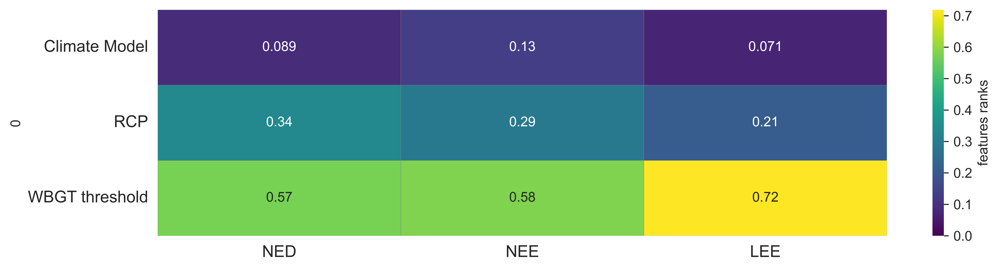

In [317]:
from ema_workbench.analysis import feature_scoring

fig6, ax6 = plt.subplots(figsize=(12,3), dpi=1000)

x = experiments2
y = new_dict_y
fs = feature_scoring.get_feature_scores_all(x, y)
ax6 = sns.heatmap(fs, cmap='viridis', annot=True,
                  vmin=0, linewidths=0.2,linecolor="grey",
                  cbar_kws={'label': 'features ranks'})

# Rotate the tick labels and set their alignment.
plt.setp(ax6.get_xticklabels(), rotation=0, size = 12, ha="center",
         rotation_mode="anchor")

plt.setp(ax6.get_yticklabels(), rotation=0, size = 12, ha="right", rotation_mode="anchor")

#ax6.legend(size=13)

plt.show()

fig6.savefig(os.path.join(rootVisualization, 'feature_scoring.svg'), format='svg', dpi=1000)
fig6.savefig(os.path.join(rootVisualization, 'feature_scoring.png'), format='png', dpi=1000)

## 3. Analysis for different RCP2.6, RCP4.5, and RCP8.5
### Calculate quantiles for each RCP scenarios

### Defining the Q0.9 and Q0.1 databases

In [318]:
print(q10_years[0])
print(q25_years[0])
print(q50_years[0])
print(q75_years[0])
print(q90_years[0])
print(q50_years.shape)

#### 2021/05/05
print(q10_years_Len[0])
print(q25_years_Len[0])
print(q50_years_Len[0])
print(q75_years_Len[0])
print(q90_years_Len[0])
print(q50_years_Len.shape)

print(q10_years_Start[0])
print(q25_years_Start[0])
print(q50_years_Start[0])
print(q75_years_Start[0])
print(q90_years_Start[0])
print(q50_years_Start.shape)

print(q10_years_End[0])
print(q25_years_End[0])
print(q50_years_End[0])
print(q75_years_End[0])
print(q90_years_End[0])
print(q50_years_End.shape)

print(q10_years_Num[0])
print(q25_years_Num[0])
print(q50_years_Num[0])
print(q75_years_Num[0])
print(q90_years_Num[0])
print(q50_years_Num.shape)

[0.]
[0.]
[0.]
[0.]
[3.]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[1.5]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[196.05]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[198.]
(119, 1)
[0.]
[0.]
[0.]
[0.]
[1.]
(119, 1)


In [319]:
print("#########")
print(matrix_HotDays26.shape)
print(matrix_HotDays45.shape)
print(matrix_HotDays85.shape)
print(len(matrix_HotDays26) + len(matrix_HotDays45) + len(matrix_HotDays85))

print("#########")
print(matrix_Num26.shape)
print(matrix_Num45.shape)
print(matrix_Num85.shape)
print(len(matrix_Num26) + len(matrix_Num45) + len(matrix_Num85))

print("#########")
print(matrix_Start26.shape)
print(matrix_Start45.shape)
print(matrix_Start85.shape)
print(len(matrix_Start26) + len(matrix_Start45) + len(matrix_Start85))

print("#########")
print(matrix_End26.shape)
print(matrix_End45.shape)
print(matrix_End85.shape)
print(len(matrix_End26) + len(matrix_End45) + len(matrix_End85))

print("#########")
print(matrix_Len26.shape)
print(matrix_Len45.shape)
print(matrix_Len85.shape)
print(len(matrix_Len26) + len(matrix_Len45) + len(matrix_Len85))

#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080
#########
(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
4080


In [320]:
print(matrix_HotDays[:, :, 1:2].shape)
print(matrix_HotDays[3, 0, 1:2])
print(matrix_HotDays[4].shape)

print(matrix_Len[:, :, 1:2].shape)
print(matrix_Len[3, 0, 1:2])
print(matrix_Len[4].shape)

(4080, 120, 1)
['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP45']
(120, 2)
(4080, 120, 1)
['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP45']
(120, 2)


In [321]:
q10_years_26 = np.quantile(matrix_HotDays26[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_26 = np.quantile(matrix_HotDays26[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_26 = np.quantile(matrix_HotDays26[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_26 = np.quantile(matrix_HotDays26[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_26 = np.quantile(matrix_HotDays26[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_45 = np.quantile(matrix_HotDays45[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_45 = np.quantile(matrix_HotDays45[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_45 = np.quantile(matrix_HotDays45[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_45 = np.quantile(matrix_HotDays45[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_45 = np.quantile(matrix_HotDays45[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_85 = np.quantile(matrix_HotDays85[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_85 = np.quantile(matrix_HotDays85[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_85 = np.quantile(matrix_HotDays85[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_85 = np.quantile(matrix_HotDays85[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_85 = np.quantile(matrix_HotDays85[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Len_26 = np.quantile(matrix_Len26[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Len_26 = np.quantile(matrix_Len26[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Len_26 = np.quantile(matrix_Len26[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Len_26 = np.quantile(matrix_Len26[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Len_26 = np.quantile(matrix_Len26[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Len_45 = np.quantile(matrix_Len45[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Len_45 = np.quantile(matrix_Len45[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Len_45 = np.quantile(matrix_Len45[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Len_45 = np.quantile(matrix_Len45[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Len_45 = np.quantile(matrix_Len45[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Len_85 = np.quantile(matrix_Len85[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Len_85 = np.quantile(matrix_Len85[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Len_85 = np.quantile(matrix_Len85[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Len_85 = np.quantile(matrix_Len85[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Len_85 = np.quantile(matrix_Len85[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_End_26 = np.quantile(matrix_End26[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_End_26 = np.quantile(matrix_End26[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_End_26 = np.quantile(matrix_End26[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_End_26 = np.quantile(matrix_End26[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_End_26 = np.quantile(matrix_End26[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_End_45 = np.quantile(matrix_End45[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_End_45 = np.quantile(matrix_End45[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_End_45 = np.quantile(matrix_End45[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_End_45 = np.quantile(matrix_End45[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_End_45 = np.quantile(matrix_End45[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_End_85 = np.quantile(matrix_End85[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_End_85 = np.quantile(matrix_End85[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_End_85 = np.quantile(matrix_End85[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_End_85 = np.quantile(matrix_End85[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_End_85 = np.quantile(matrix_End85[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Start_26 = np.quantile(matrix_Start26[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Start_26 = np.quantile(matrix_Start26[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Start_26 = np.quantile(matrix_Start26[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Start_26 = np.quantile(matrix_Start26[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Start_26 = np.quantile(matrix_Start26[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Start_45 = np.quantile(matrix_Start45[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Start_45 = np.quantile(matrix_Start45[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Start_45 = np.quantile(matrix_Start45[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Start_45 = np.quantile(matrix_Start45[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Start_45 = np.quantile(matrix_Start45[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Start_85 = np.quantile(matrix_Start85[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Start_85 = np.quantile(matrix_Start85[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Start_85 = np.quantile(matrix_Start85[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Start_85 = np.quantile(matrix_Start85[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Start_85 = np.quantile(matrix_Start85[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Num_26 = np.quantile(matrix_Num26[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Num_26 = np.quantile(matrix_Num26[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Num_26 = np.quantile(matrix_Num26[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Num_26 = np.quantile(matrix_Num26[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Num_26 = np.quantile(matrix_Num26[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Num_45 = np.quantile(matrix_Num45[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Num_45 = np.quantile(matrix_Num45[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Num_45 = np.quantile(matrix_Num45[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Num_45 = np.quantile(matrix_Num45[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Num_45 = np.quantile(matrix_Num45[:, 1:, 1:2].astype(float), 0.9, axis=0)

q10_years_Num_85 = np.quantile(matrix_Num85[:, 1:, 1:2].astype(float), 0.1, axis=0)
q25_years_Num_85 = np.quantile(matrix_Num85[:, 1:, 1:2].astype(float), 0.25, axis=0)
q50_years_Num_85 = np.quantile(matrix_Num85[:, 1:, 1:2].astype(float), 0.5, axis=0)
q75_years_Num_85 = np.quantile(matrix_Num85[:, 1:, 1:2].astype(float), 0.75, axis=0)
q90_years_Num_85 = np.quantile(matrix_Num85[:, 1:, 1:2].astype(float), 0.9, axis=0)

#### Make dataframes from quantiles

In [322]:
dfq50_26 = pd.DataFrame(q50_years_26)
dfq50_26.columns = ['median26']
dfq50_45 = pd.DataFrame(q50_years_45)
dfq50_45.columns = ['median45']
dfq50_85 = pd.DataFrame(q50_years_85)
dfq50_85.columns = ['median85']

dfq90_26 = pd.DataFrame(q90_years_26)
dfq90_26.columns = ['Q90_26']
dfq90_45 = pd.DataFrame(q90_years_45)
dfq90_45.columns = ['Q90_45']
dfq90_85 = pd.DataFrame(q90_years_85)
dfq90_85.columns = ['Q90_85']

dfq10_26 = pd.DataFrame(q10_years_26)
dfq10_26.columns = ['Q10_26']
dfq10_45 = pd.DataFrame(q10_years_45)
dfq10_45.columns = ['Q10_45']
dfq10_85 = pd.DataFrame(q10_years_85)
dfq10_85.columns = ['Q10_85']

dfq50_Len_26 = pd.DataFrame(q50_years_Len_26)
dfq50_Len_26.columns = ['median26']
dfq50_Len_45 = pd.DataFrame(q50_years_Len_45)
dfq50_Len_45.columns = ['median45']
dfq50_Len_85 = pd.DataFrame(q50_years_Len_85)
dfq50_Len_85.columns = ['median85']

dfq90_Len_26 = pd.DataFrame(q90_years_Len_26)
dfq90_Len_26.columns = ['median26']
dfq90_Len_45 = pd.DataFrame(q90_years_Len_45)
dfq90_Len_45.columns = ['median45']
dfq90_Len_85 = pd.DataFrame(q90_years_Len_85)
dfq90_Len_85.columns = ['median85']

dfq10_Len_26 = pd.DataFrame(q10_years_Len_26)
dfq10_Len_26.columns = ['median26']
dfq10_Len_45 = pd.DataFrame(q10_years_Len_45)
dfq10_Len_45.columns = ['median45']
dfq10_Len_85 = pd.DataFrame(q10_years_Len_85)
dfq10_Len_85.columns = ['median85']

dfq50_Num_26 = pd.DataFrame(q50_years_Num_26)
dfq50_Num_26.columns = ['median26']
dfq50_Num_45 = pd.DataFrame(q50_years_Num_45)
dfq50_Num_45.columns = ['median45']
dfq50_Num_85 = pd.DataFrame(q50_years_Num_85)
dfq50_Num_85.columns = ['median85']

dfq90_Num_26 = pd.DataFrame(q90_years_Num_26)
dfq90_Num_26.columns = ['median26']
dfq90_Num_45 = pd.DataFrame(q90_years_Num_45)
dfq90_Num_45.columns = ['median45']
dfq90_Num_85 = pd.DataFrame(q90_years_Num_85)
dfq90_Num_85.columns = ['median85']

dfq10_Num_26 = pd.DataFrame(q10_years_Num_26)
dfq10_Num_26.columns = ['median26']
dfq10_Num_45 = pd.DataFrame(q10_years_Num_45)
dfq10_Num_45.columns = ['median45']
dfq10_Num_85 = pd.DataFrame(q10_years_Num_85)
dfq10_Num_85.columns = ['median85']

In [323]:
dfq50_26.head()

,median26
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0


In [324]:
dfAllAverages = pd.concat((dfq50_26, dfq50_45, dfq50_85), axis=1)
dfAllAverages_Q90 = pd.concat((dfq90_26, dfq90_45, dfq90_85), axis=1)
dfAllAverages_Q10 = pd.concat((dfq10_26, dfq10_45, dfq10_85), axis=1)

dfAllAverages_Num = pd.concat((dfq50_Num_26, dfq50_Num_45, dfq50_Num_85), axis=1)
dfAllAverages_Q90_Num = pd.concat((dfq90_Num_26, dfq90_Num_45, dfq90_Num_85), axis=1)
dfAllAverages_Q10_Num = pd.concat((dfq10_Num_26, dfq10_Num_45, dfq10_Num_85), axis=1)

dfAllAverages_Len = pd.concat((dfq50_Len_26, dfq50_Len_45, dfq50_Len_85), axis=1)
dfAllAverages_Q90_Len = pd.concat((dfq90_Len_26, dfq90_Len_45, dfq90_Len_85), axis=1)
dfAllAverages_Q10_Len = pd.concat((dfq10_Len_26, dfq10_Len_45, dfq10_Len_85), axis=1)

In [325]:
dfAllAverages.head()

,median26,median45,median85
0,0.0,0.0,0.0
1,0.0,0.0,0.0
2,0.0,0.0,0.0
3,0.0,0.0,0.0
4,0.0,1.0,1.0


In [326]:
print('*** All RCPs***')
print(q10_years[0])
print(q25_years[0])
print(q50_years[0])
print(q75_years[0])
print(q90_years[0])
print(q50_years.shape)
print('*** RCP2.6***')
print(q10_years_26[0])
print(q25_years_26[0])
print(q50_years_26[0])
print(q75_years_26[0])
print(q90_years_26[0])
print(q50_years_26.shape)
print('*** RCP4.5***')
print(q10_years_45[0])
print(q25_years_45[0])
print(q50_years_45[0])
print(q75_years_45[0])
print(q90_years_45[0])
print(q50_years_45.shape)
print('*** RCP8.5***')
print(q10_years_85[0])
print(q25_years_85[0])
print(q50_years_85[0])
print(q75_years_85[0])
print(q90_years_85[0])
print(q50_years_85.shape)

*** All RCPs***
[0.]
[0.]
[0.]
[0.]
[3.]
(119, 1)
*** RCP2.6***
[0.]
[0.]
[0.]
[0.]
[3.]
(119, 1)
*** RCP4.5***
[0.]
[0.]
[0.]
[1.]
[3.]
(119, 1)
*** RCP8.5***
[0.]
[0.]
[0.]
[0.]
[2.]
(119, 1)


#### Set the parameters of making figure

In [327]:
p_Step = 1
#alpha_Fade = 0.61
alpha_Fade = 0.91

In [328]:
'''Observation'''
fig18, axs = plt.subplots(figsize=(15,5), dpi=1000)
sns.set_style("darkgrid")

x_axis_obs = np.arange(1981, 2021, step=1)

for i in range(0, len(matrix_HotDays_obs), p_Step):
    a = matrix_HotDays_obs[i, 1:, 1:2].astype(float)
    axs.plot(x_axis_obs, a[:,0], color='lightgreen', linestyle = '--')

axs.plot(x_axis_obs, q10_years_obs[:], color='black', linewidth = 1, alpha=1)
#axs.plot(x_axis_obs, q25_years_obs[:], color='blue',linewidth = 1.5, alpha=1)
axs.plot(x_axis_obs, q50_years_obs[:], color='black', linewidth = 2, alpha=1)
#axs.plot(x_axis_obs, q75_years_obs[:], color='yellow', linewidth = 1.5, alpha=1)
axs.plot(x_axis_obs, q90_years_obs[:], color='black', linewidth = 1, alpha=1)

axs.set_title(f'Number of extreme days per year in {station} \n 1981 - 2020', fontsize= 25, pad=20)
axs.set_xlabel('year', size=20, labelpad=20)
axs.set_ylabel('# of days', size=20, labelpad=20)
axs.set_ylim(bottom=0, top =40)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
axs.xaxis.set_ticks(np.arange(1980, 2021, 10))

plt.axvline(x=2003, color='red', linewidth=1)
plt.axvline(x=2015, color='red', linewidth=1)

fig18.savefig(os.path.join(rootVisualization, 'Number_extreme_days_obs.png'), format='png', dpi=300)

plt.show()

In [356]:
'''RCP'''
fig18, axs = plt.subplots(3,1, figsize=(8,8), dpi = 1000)
sns.set_style("darkgrid")

x_axis = np.arange(1981, 2100, step=1)

for i in range(0, len(matrix_HotDays26), p_Step):
    a = matrix_HotDays26[i, 1:, 1:2].astype(float)
    axs[0].plot(x_axis, a[:,0], color='pink', linestyle = '--', linewidth = .5, alpha=1)

for i in range(0, len(matrix_HotDays45), p_Step):
    a = matrix_HotDays45[i, 1:, 1:2].astype(float)
    axs[1].plot(x_axis, a[:,0], color='orange', linestyle = '--', linewidth = .5, alpha=1)

for i in range(0, len(matrix_HotDays85), p_Step):
    a = matrix_HotDays85[i, 1:, 1:2].astype(float)
    axs[2].plot(x_axis, a[:,0], color='red', linestyle = '--', linewidth = .5, alpha=1)     

axs[0].plot(x_axis, q10_years_26, color='black', linewidth = .5, alpha=1)
axs[0].plot(x_axis, q50_years_26, color='black', linewidth = 1, alpha=1)
axs[0].plot(x_axis, q90_years_26, color='black', linewidth = .5, alpha=1)
axs[1].plot(x_axis, q10_years_45, color='black', linewidth = .5, alpha=1)
axs[1].plot(x_axis, q50_years_45, color='black', linewidth = 1, alpha=1)
axs[1].plot(x_axis, q90_years_45, color='black', linewidth = .5, alpha=1)
axs[2].plot(x_axis, q10_years_85, color='black', linewidth = .5, alpha=1)
axs[2].plot(x_axis, q50_years_85, color='black', linewidth = 1, alpha=1)
axs[2].plot(x_axis, q90_years_85, color='black', linewidth = .5, alpha=1)

axs[0].axhline(y=20, linewidth=.5, color='blue')
axs[0].axhline(y=40, linewidth=.5, color='darkblue')
axs[1].axhline(y=20, linewidth=.5, color='blue')
axs[1].axhline(y=40, linewidth=.5, color='darkblue')
axs[2].axhline(y=20, linewidth=.5, color='blue')
axs[2].axhline(y=40, linewidth=.5, color='darkblue')

axs[0].set_title(f'Number of extreme days per year in {station} \n 1981 - 2099', fontsize=12, pad=10)
axs[2].set_xlabel('year', fontsize=10, labelpad=10)
axs[1].set_ylabel('# of days', fontsize=10, labelpad=10)
axs[0].set_ylim(bottom=0, top=110)
axs[1].set_ylim(bottom=0, top = 110)
axs[2].set_ylim(bottom=0, top =110)
axs[0].yaxis.set_ticks(np.arange(0, 110, 20))
axs[1].yaxis.set_ticks(np.arange(0, 110, 20))
axs[2].yaxis.set_ticks(np.arange(0, 110, 20))
axs[0].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[1].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[2].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[0].tick_params(axis='x', labelsize=10)
axs[1].tick_params(axis='x', labelsize=10)
axs[2].tick_params(axis='x', labelsize=10)
axs[0].tick_params(axis='y', labelsize=10)
axs[1].tick_params(axis='y', labelsize=10)
axs[2].tick_params(axis='y', labelsize=10)

axs[0].annotate('RCP 2.6', fontsize=10, xy=(1985, 100), xytext=(0, 0), textcoords='offset points', ha='center', va='center')
axs[1].annotate('RCP 4.5', fontsize=10, xy=(1985, 100), xytext=(0, 0), textcoords='offset points', ha='center', va='center')
axs[2].annotate('RCP 8.5', fontsize=10, xy=(1985, 100), xytext=(0, 0), textcoords='offset points', ha='center', va='center')

fig18.savefig(os.path.join(rootVisualization, 'NED_26_45_85.png'), format='png', dpi=1000)

plt.show()

[0.21224203]
[-418.75267355]
[0.01649338]
[-32.15489247]
[0.08478849]
[-169.12398519]
[0.24232303]
[-485.58268053]


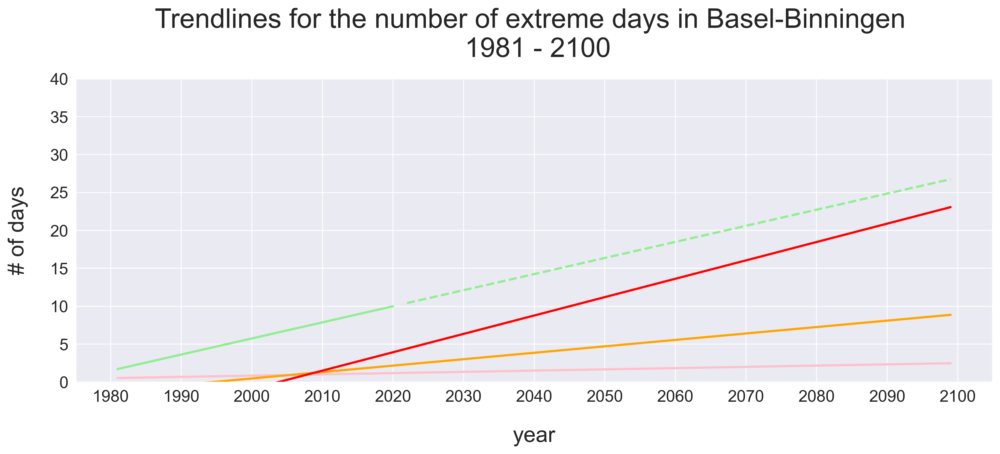

In [330]:
'''Trends'''
x_axis_obs = np.arange(1981, 2021, step=1)
slope_obs, intercect_obs = np.polyfit(x_axis_obs, q50_years_obs, 1)
print(slope_obs)
print(intercect_obs)

x_axis = np.arange(1981, 2100, step=1)
slope_26, intercect_26 = np.polyfit(x_axis, q50_years_26, 1)
print(slope_26)
print(intercect_26)

x_axis = np.arange(1981, 2100, step=1)
slope_45, intercect_45 = np.polyfit(x_axis, q50_years_45, 1)
print(slope_45)
print(intercect_45)

x_axis = np.arange(1981, 2100, step=1)
slope_85, intercect_85 = np.polyfit(x_axis, q50_years_85, 1)
print(slope_85)
print(intercect_85)

'''Plot the trendlines'''
fig18, axs = plt.subplots(figsize=(15,5), dpi=300)
sns.set_style("darkgrid")

x_axis_obs = np.arange(1981, 2021, step=1)
x_axis_obs_2 = np.arange(2022, 2100, step=1)
x_axis = np.arange(1981, 2100, step=1)

y_axis_obs = [slope_obs * i_obs + intercect_obs for i_obs in x_axis_obs]
y_axis_obs_2 = [slope_obs * i_obs + intercect_obs for i_obs in x_axis_obs_2]
y_axis_26 = [slope_26 * i_26 + intercect_26 for i_26 in x_axis]
y_axis_45 = [slope_45 * i_45 + intercect_45 for i_45 in x_axis]
y_axis_85 = [slope_85 * i_85 + intercect_85 for i_85 in x_axis]

plt.plot(x_axis_obs_2, y_axis_obs_2, color='lightgreen', linewidth=2, linestyle='--')
plt.plot(x_axis_obs, y_axis_obs, color='lightgreen', linewidth=2)
plt.plot(x_axis, y_axis_26, color='pink', linewidth=2)
plt.plot(x_axis, y_axis_45, color='orange', linewidth=2)
plt.plot(x_axis, y_axis_85, color='red', linewidth=2)

axs.set_title(f'Trendlines for the number of extreme days in {station} \n 1981 - 2100', fontsize= 25, pad=20)
axs.set_xlabel('year', size=20, labelpad=20)
axs.set_ylabel('# of days', size=20, labelpad=20)
axs.set_ylim(bottom=0, top =40)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
axs.xaxis.set_ticks(np.arange(1980, 2101, 10))

fig18.savefig(os.path.join(rootVisualization, 'Trends_number_extreme_days.png'), format='png', dpi=300)

plt.show()

In [331]:
len(matrix_HotDays26)

1350

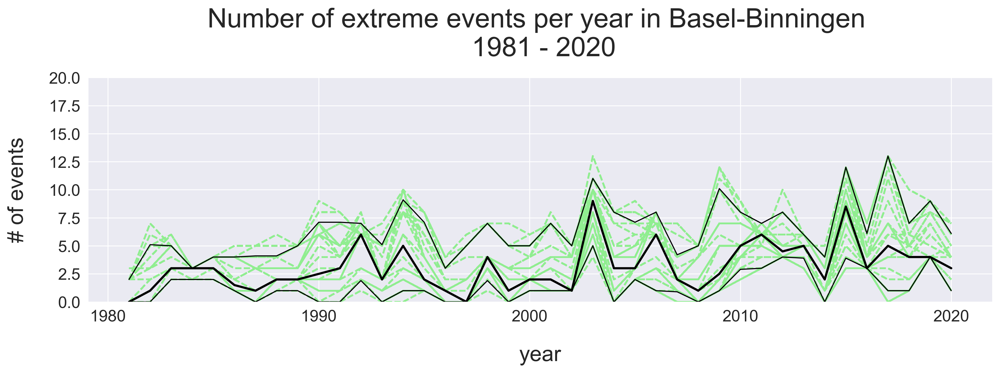

In [332]:
'''Observation'''
fig18, axs = plt.subplots(figsize=(15,3.75), dpi=300)
sns.set_style("darkgrid")

x_axis_obs = np.arange(1981, 2021, step=1)

for i in range(0, len(matrix_Num_obs), p_Step):
    a = matrix_Num_obs[i, 1:, 1:2].astype(float)
    axs.plot(x_axis_obs, a[:,0], color='lightgreen', linestyle = '--')

axs.plot(x_axis_obs, q10_years_Num_obs[:], color='black', linewidth = 1, alpha=1)
#axs.plot(x_axis_obs, q10_years_Num_obs[:], color='blue',linewidth = 1.5, alpha=1)
axs.plot(x_axis_obs, q50_years_Num_obs[:], color='black', linewidth = 2, alpha=1)
#axs.plot(x_axis_obs, q75_years_Num_obs[:], color='yellow', linewidth = 1.5, alpha=1)
axs.plot(x_axis_obs, q90_years_Num_obs[:], color='black', linewidth = 1, alpha=1)

axs.set_title(f'Number of extreme events per year in {station} \n 1981 - 2020', fontsize=25, pad=20)
axs.set_xlabel('year', size=20, labelpad=20)
axs.set_ylabel('# of events', size=20, labelpad=20)
axs.set_ylim(bottom=0, top =20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
axs.xaxis.set_ticks(np.arange(1980, 2021, 10))

fig18.savefig(os.path.join(rootVisualization, 'Number_extreme_events_obs.png'), format='png', dpi=300)

plt.show()

In [357]:
'''RCP'''
fig21, axs = plt.subplots(3,1, figsize=(8,8), dpi=1000)
sns.set_style("darkgrid")

x_axis = np.arange(1981, 2100, step=1)

for i in range(0, len(matrix_Num26), p_Step):
    a = matrix_Num26[i, 1:, 1:2].astype(float)
    axs[0].plot(x_axis, a[:,0], color='pink', linestyle = '--', linewidth = .5, alpha=1)

for i in range(0, len(matrix_Num45), p_Step):
    a = matrix_Num45[i, 1:, 1:2].astype(float)
    axs[1].plot(x_axis, a[:,0], color='orange', linestyle = '--', linewidth = .5, alpha=1)


for i in range(0, len(matrix_Num85), p_Step):
    a = matrix_Num85[i, 1:, 1:2].astype(float)
    axs[2].plot(x_axis, a[:,0], color='red', linestyle = '--', linewidth = .5, alpha=1)    

axs[0].plot(x_axis, q10_years_Num_26, color='black', linewidth = .5, alpha=1)
axs[0].plot(x_axis, q50_years_Num_26, color='black', linewidth = 1, alpha=1)
axs[0].plot(x_axis, q90_years_Num_26, color='black', linewidth = .5, alpha=1)
axs[1].plot(x_axis, q10_years_Num_45, color='black', linewidth = .5, alpha=1)
axs[1].plot(x_axis, q50_years_Num_45, color='black', linewidth = 1, alpha=1)
axs[1].plot(x_axis, q90_years_Num_45, color='black', linewidth = .5, alpha=1)
axs[2].plot(x_axis, q10_years_Num_85, color='black', linewidth = .5, alpha=1)
axs[2].plot(x_axis, q50_years_Num_85, color='black', linewidth = 1, alpha=1)
axs[2].plot(x_axis, q90_years_Num_85, color='black', linewidth = .5, alpha=1)

axs[0].axhline(y=5, linewidth=.5, color='blue')
axs[0].axhline(y=8, linewidth=.5, color='darkblue')
axs[1].axhline(y=5, linewidth=.5, color='blue')
axs[1].axhline(y=8, linewidth=.5, color='darkblue')
axs[2].axhline(y=5, linewidth=.5, color='blue')
axs[2].axhline(y=8, linewidth=.5, color='darkblue')

axs[0].set_title(f'Number of extreme events per year in {station} \n 1981 - 2099', fontsize=12, pad=10)
axs[2].set_xlabel('year', fontsize=10, labelpad=10)
axs[1].set_ylabel('# of events', fontsize=10, labelpad=10)
axs[0].set_ylim(bottom=0, top=10)
axs[1].set_ylim(bottom=0, top = 10)
axs[2].set_ylim(bottom=0, top =10)
axs[0].yaxis.set_ticks(np.arange(0, 21, 2.5))
axs[1].yaxis.set_ticks(np.arange(0, 21, 2.5))
axs[2].yaxis.set_ticks(np.arange(0, 21, 2.5))
axs[0].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[1].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[2].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[0].tick_params(axis='x', labelsize=10)
axs[1].tick_params(axis='x', labelsize=10)
axs[2].tick_params(axis='x', labelsize=10)
axs[0].tick_params(axis='y', labelsize=10)
axs[1].tick_params(axis='y', labelsize=10)
axs[2].tick_params(axis='y', labelsize=10)

axs[0].annotate('RCP 2.6', fontsize=10, xy=(1984, 18), xytext=(0, 0), textcoords='offset points', ha='center', va='center')
axs[1].annotate('RCP 4.5', fontsize=10, xy=(1984, 18), xytext=(0, 0), textcoords='offset points', ha='center', va='center')
axs[2].annotate('RCP 8.5', fontsize=10, xy=(1984, 18), xytext=(0, 0), textcoords='offset points', ha='center', va='center')

fig21.savefig(os.path.join(rootVisualization, 'NEE_26_45_85.png'), format='png', dpi=1000)

plt.show()

[0.07481238]
[-146.54967167]
[0.01085315]
[-21.14043584]
[0.04024356]
[-79.9876086]
[0.08247757]
[-164.60297678]


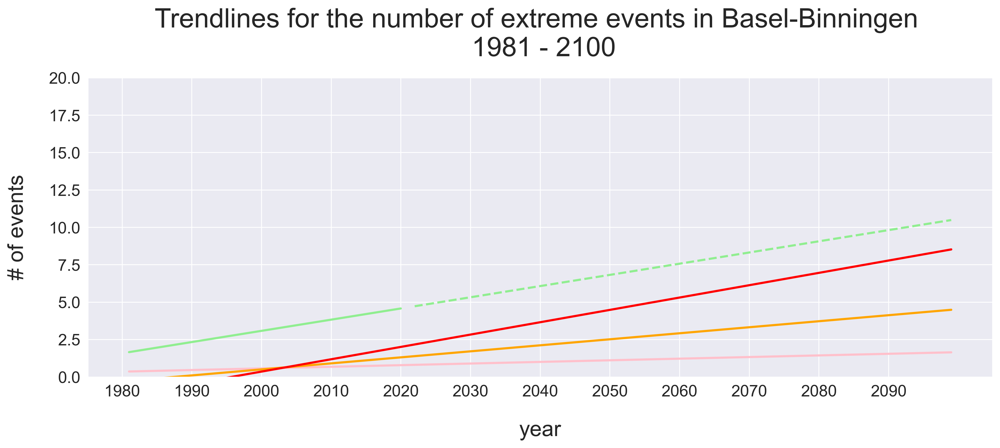

In [334]:
'''Trends'''
x_axis_obs = np.arange(1981, 2021, step=1)
slope_obs_events, intercect_obs_events = np.polyfit(x_axis_obs, q50_years_Num_obs, 1)
print(slope_obs_events)
print(intercect_obs_events)

x_axis = np.arange(1981, 2100, step=1)
slope_26_events, intercect_26_events = np.polyfit(x_axis, q50_years_Num_26, 1)
print(slope_26_events)
print(intercect_26_events)

x_axis = np.arange(1981, 2100, step=1)
slope_45_events, intercect_45_events = np.polyfit(x_axis, q50_years_Num_45, 1)
print(slope_45_events)
print(intercect_45_events)

x_axis = np.arange(1981, 2100, step=1)
slope_85_events, intercect_85_events = np.polyfit(x_axis, q50_years_Num_85, 1)
print(slope_85_events)
print(intercect_85_events)

'''Plot the trendlines'''
fig18, axs = plt.subplots(figsize=(15,5), dpi=300)
sns.set_style("darkgrid")

x_axis_obs = np.arange(1981, 2021, step=1)
x_axis_obs_2 = np.arange(2022, 2100, step=1)
x_axis = np.arange(1981, 2100, step=1)

y_axis_obs = [slope_obs_events * i_obs_events + intercect_obs_events for i_obs_events in x_axis_obs]
y_axis_obs_2 = [slope_obs_events * i_obs_events + intercect_obs_events for i_obs_events in x_axis_obs_2]
y_axis_26 = [slope_26_events * i_26_events + intercect_26_events for i_26_events in x_axis]
y_axis_45 = [slope_45_events * i_45_events + intercect_45_events for i_45_events in x_axis]
y_axis_85 = [slope_85_events * i_85_events + intercect_85_events for i_85_events in x_axis]

plt.plot(x_axis_obs_2, y_axis_obs_2, color='lightgreen', linewidth=2, linestyle='--')
plt.plot(x_axis_obs, y_axis_obs, color='lightgreen', linewidth=2)
plt.plot(x_axis, y_axis_26, color='pink', linewidth=2)
plt.plot(x_axis, y_axis_45, color='orange', linewidth=2)
plt.plot(x_axis, y_axis_85, color='red', linewidth=2)

axs.set_title(f'Trendlines for the number of extreme events in {station} \n 1981 - 2100', fontsize= 25, pad=20)
axs.set_xlabel('year', size=20, labelpad=20)
axs.set_ylabel('# of events', size=20, labelpad=20)
axs.set_ylim(bottom=0, top =20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
axs.xaxis.set_ticks(np.arange(1980, 2100, 10))

fig18.savefig(os.path.join(rootVisualization, 'Trends_number_extreme_events.png'), format='png', dpi=300)

plt.show()

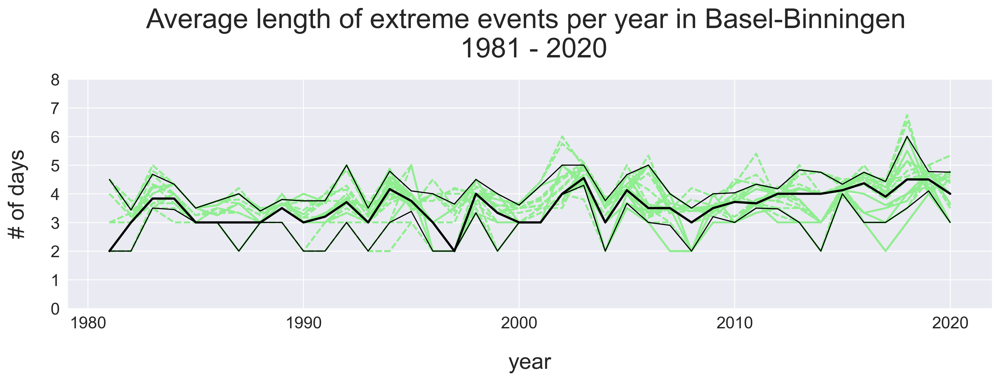

In [335]:
'''Observation'''
fig18, axs = plt.subplots(figsize=(15,3.75), dpi=300)
sns.set_style("darkgrid")

x_axis_obs = np.arange(1981, 2021, step=1)

for i in range(0, len(matrix_Len_obs), p_Step):
    a = matrix_Len_obs[i, 1:, 1:2].astype(float)
    axs.plot(x_axis_obs, (a[:,0] + 2), color='lightgreen', linestyle = '--')

axs.plot(x_axis_obs, q10_years_Len_obs[:] +2, color='black', linewidth = 1, alpha=1)
#axs.plot(x_axis_obs, q10_years_Len_obs[:] +2, color='blue',linewidth = 1.5, alpha=1)
axs.plot(x_axis_obs, q50_years_Len_obs[:] +2, color='black', linewidth = 2, alpha=1)
#axs.plot(x_axis_obs, q75_years_Len_obs[:] +2, color='yellow', linewidth = 1.5, alpha=1)
axs.plot(x_axis_obs, q90_years_Len_obs[:] +2, color='black', linewidth = 1, alpha=1)

axs.set_title(f'Average length of extreme events per year in {station} \n 1981 - 2020', fontsize=25, pad=20)
axs.set_xlabel('year', size=20, labelpad=20)
axs.set_ylabel('# of days', size=20, labelpad=20)
axs.set_ylim(bottom=0, top =8)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
axs.xaxis.set_ticks(np.arange(1980, 2021, 10))

fig18.savefig(os.path.join(rootVisualization, 'Ave_length_extreme_events_obs.png'), format='png', dpi=300)

plt.show()

In [358]:
'''RCP'''
fig21, axs = plt.subplots(3,1, figsize=(8,8), dpi=1000)
sns.set_style("darkgrid")

x_axis = np.arange(1981, 2100, step=1)

for i in range(0, len(matrix_Len26), p_Step):
    a = matrix_Len26[i, 1:, 1:2].astype(float)
    axs[0].plot(x_axis, a[:,0] +2, color='pink', linestyle = '--', linewidth = .5, alpha=1)

for i in range(0, len(matrix_Len45), p_Step):
    a = matrix_Len45[i, 1:, 1:2].astype(float)
    axs[1].plot(x_axis, a[:,0] +2, color='orange', linestyle = '--', linewidth = .5, alpha=1)

for i in range(0, len(matrix_Len85), p_Step):
    a = matrix_Len85[i, 1:, 1:2].astype(float)
    axs[2].plot(x_axis, a[:,0] +2, color='red', linestyle = '--', linewidth = .5, alpha=1)    

axs[0].plot(x_axis, q10_years_Len_26+2, color='black', linewidth = .5, alpha=1)
axs[0].plot(x_axis, q50_years_Len_26+2, color='black', linewidth = 1, alpha=1)
axs[0].plot(x_axis, q90_years_Len_26+2, color='black', linewidth = .5, alpha=1)
axs[1].plot(x_axis, q10_years_Len_45+2, color='black', linewidth = .5, alpha=1)
axs[1].plot(x_axis, q50_years_Len_45+2, color='black', linewidth = 1, alpha=1)
axs[1].plot(x_axis, q90_years_Len_45+2, color='black', linewidth = .5, alpha=1)
axs[2].plot(x_axis, q10_years_Len_85+2, color='black', linewidth = .5, alpha=1)
axs[2].plot(x_axis, q50_years_Len_85+2, color='black', linewidth = 1, alpha=1)
axs[2].plot(x_axis, q90_years_Len_85+2, color='black', linewidth = .5, alpha=1)

axs[0].axhline(y=5, linewidth=.5, color='blue')
axs[1].axhline(y=5, linewidth=.5, color='blue')
axs[2].axhline(y=5, linewidth=.5, color='blue')

axs[0].set_title(f'Average length of extreme events per year in {station} \n 1981 - 2099', fontsize=12, pad=10)
axs[2].set_xlabel('year', fontsize=10, labelpad=10)
axs[1].set_ylabel('# of days', fontsize=10, labelpad=10)
axs[0].set_ylim(bottom=0, top=15)
axs[1].set_ylim(bottom=0, top = 15)
axs[2].set_ylim(bottom=0, top =15)
axs[0].yaxis.set_ticks(np.arange(0, 16, 2.5))
axs[1].yaxis.set_ticks(np.arange(0, 16, 2.5))
axs[2].yaxis.set_ticks(np.arange(0, 16, 2.5))
axs[0].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[1].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[2].xaxis.set_ticks(np.arange(1980, 2101, 10))
axs[0].tick_params(axis='x', labelsize=10)
axs[1].tick_params(axis='x', labelsize=10)
axs[2].tick_params(axis='x', labelsize=10)
axs[0].tick_params(axis='y', labelsize=10)
axs[1].tick_params(axis='y', labelsize=10)
axs[2].tick_params(axis='y', labelsize=10)

axs[0].annotate('RCP 2.6', fontsize=10, xy=(1984, 13), xytext=(0, 0), textcoords='offset points', ha='center', va='center')
axs[1].annotate('RCP 4.5', fontsize=10, xy=(1984, 13), xytext=(0, 0), textcoords='offset points', ha='center', va='center')
axs[2].annotate('RCP 8.5', fontsize=10, xy=(1984, 13), xytext=(0, 0), textcoords='offset points', ha='center', va='center')

fig21.savefig(os.path.join(rootVisualization, 'LEE_26_45_85.png'), format='png', dpi=1000)

plt.show()

[0.0307943]
[-60.07229033]
[0.00914864]
[-17.85900903]
[0.01803156]
[-35.5692165]
[0.02481766]
[-49.02278928]


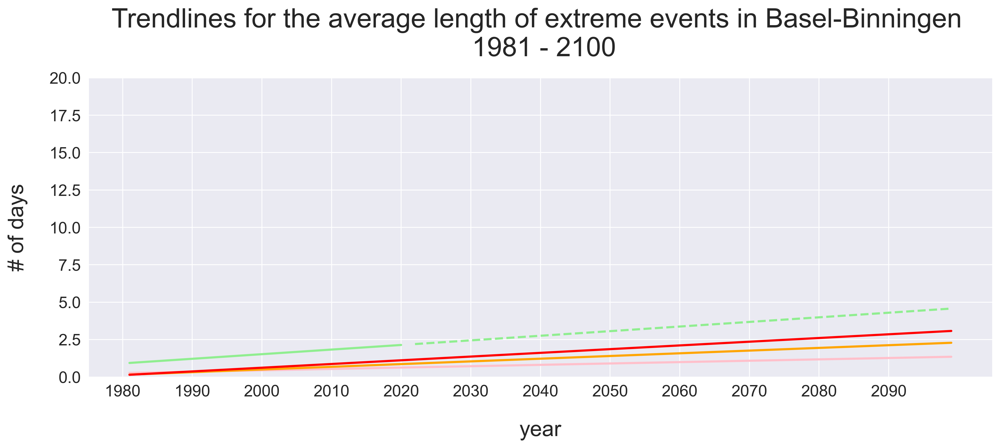

In [337]:
'''Trends'''
x_axis_obs = np.arange(1981, 2021, step=1)
slope_obs_length, intercect_obs_length = np.polyfit(x_axis_obs, q50_years_Len_obs, 1)
print(slope_obs_length)
print(intercect_obs_length)

x_axis = np.arange(1981, 2100, step=1)
slope_26_length, intercect_26_length = np.polyfit(x_axis, q50_years_Len_26, 1)
print(slope_26_length)
print(intercect_26_length)

x_axis = np.arange(1981, 2100, step=1)
slope_45_length, intercect_45_length = np.polyfit(x_axis, q50_years_Len_45, 1)
print(slope_45_length)
print(intercect_45_length)

x_axis = np.arange(1981, 2100, step=1)
slope_85_length, intercect_85_length = np.polyfit(x_axis, q50_years_Len_85, 1)
print(slope_85_length)
print(intercect_85_length)

'''Plot the trendlines'''
fig18, axs = plt.subplots(figsize=(15,5), dpi=300)
sns.set_style("darkgrid")

x_axis_obs = np.arange(1981, 2021, step=1)
x_axis_obs_2 = np.arange(2022, 2100, step=1)
x_axis = np.arange(1981, 2100, step=1)

y_axis_obs = [slope_obs_length * i_obs_length + intercect_obs_length for i_obs_length in x_axis_obs]
y_axis_obs_2 = [slope_obs_length * i_obs_length + intercect_obs_length for i_obs_length in x_axis_obs_2]
y_axis_26 = [slope_26_length * i_26_length + intercect_26_length for i_26_length in x_axis]
y_axis_45 = [slope_45_length * i_45_length + intercect_45_length for i_45_length in x_axis]
y_axis_85 = [slope_85_length * i_85_length + intercect_85_length for i_85_length in x_axis]

plt.plot(x_axis_obs_2, y_axis_obs_2, color='lightgreen', linewidth=2, linestyle='--')
plt.plot(x_axis_obs, y_axis_obs, color='lightgreen', linewidth=2)
plt.plot(x_axis, y_axis_26, color='pink', linewidth=2)
plt.plot(x_axis, y_axis_45, color='orange', linewidth=2)
plt.plot(x_axis, y_axis_85, color='red', linewidth=2)

axs.set_title(f'Trendlines for the average length of extreme events in {station} \n 1981 - 2100', fontsize= 25, pad=20)
axs.set_xlabel('year', size=20, labelpad=20)
axs.set_ylabel('# of days', size=20, labelpad=20)
axs.set_ylim(bottom=0, top =20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
axs.xaxis.set_ticks(np.arange(1980, 2100, 10))

fig18.savefig(os.path.join(rootVisualization, 'Trends_length_extreme_events.png'), format='png', dpi=300)

plt.show()

In [338]:
dfAllAverages.head()

,median26,median45,median85
0,0.0,0.0,0.0
1,0.0,0.0,0.0
2,0.0,0.0,0.0
3,0.0,0.0,0.0
4,0.0,1.0,1.0


### Making dataframes for all RCP2.6 , RCP4.5, and RCP8.5 scenarios

In [339]:
print(matrix_HotDays26.shape)
print(matrix_HotDays45.shape)
print(matrix_HotDays85.shape)
print(matrix_HotDays.shape)

(1350, 120, 2)
(1380, 120, 2)
(1350, 120, 2)
(4080, 120, 2)


In [340]:
pd.DataFrame((matrix_HotDays26[0][1:,0:1]), columns=matrix_HotDays26[0,0,0:1]).head()

,Season
0,1981
1,1982
2,1983
3,1984
4,1985


In [341]:
df26_all = pd.DataFrame((matrix_HotDays26[0][1:,0:1]), columns=matrix_HotDays26[0,0,0:1])
for i in range(len(matrix_HotDays26)):
    b = pd.DataFrame(matrix_HotDays26[i][1:,1:], columns=['sc_'+ str(i+1) + '_'+ str(matrix_HotDays26[i,0,1:])])
    df26_all = pd.concat((df26_all, b), axis = 1)

In [342]:
df26_all.head(7)
df26_all.to_csv(os.path.join(rootVisualization, 'df26_all.csv'), index = False)

In [343]:
matrix_HotDays45[2,0,1:]

array(['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP45'],
      dtype='<U54')

In [344]:
df45_all = pd.DataFrame((matrix_HotDays45[0][1:,0:1]), columns=matrix_HotDays45[0,0,0:1])
for i in range(len(matrix_HotDays45)):
    b = pd.DataFrame(matrix_HotDays45[i][1:,1:], columns=['sc_'+ str(i+1) + '_'+ str(matrix_HotDays45[i,0,1:])])

    df45_all = pd.concat((df45_all, b), axis = 1)

In [345]:
df45_all.head(7)
df45_all.to_csv(os.path.join(rootVisualization, 'df45_all.csv'), index = False)

In [346]:
df85_all = pd.DataFrame((matrix_HotDays85[0][1:,0:1]), columns=matrix_HotDays85[0,0,0:1])
for i in range(len(matrix_HotDays85)):
    b = pd.DataFrame(matrix_HotDays85[i][1:,1:], columns=['sc_'+ str(i+1) + '_'+ str(matrix_HotDays85[i,0,1:])])

    df85_all = pd.concat((df85_all, b), axis = 1)

In [347]:
df85_all.head(7)
df85_all.to_csv(os.path.join(rootVisualization, 'df85_all.csv'), index = False)

In [348]:
df26_all_Matrix = df26_all.to_numpy()
df45_all_Matrix = df45_all.to_numpy()
df85_all_Matrix = df85_all.to_numpy()

In [349]:
df26_all_Num = pd.DataFrame((matrix_Num26[0][1:,0:1]), columns=matrix_Num26[0,0,0:1])
for i in range(len(matrix_Num26)):
    b = pd.DataFrame(matrix_Num26[i][1:,1:], columns=['sc_'+ str(i+1) + '_'+ str(matrix_Num26[i,0,1:])])
    df26_all_Num = pd.concat((df26_all_Num, b), axis = 1)

In [350]:
df26_all_Num.head(7)

,Season,sc_1_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR11-RCP26'],sc_2_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_3_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_4_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_5_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_6_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_7_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_8_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_9_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_10_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_11_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP26'],sc_12_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_13_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR11-RCP26'],sc_14_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_15_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_16_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_17_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_18_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_19_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_20_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP26'],sc_21_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_22_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP26'],sc_23_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_24_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_25_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_26_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_27_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_28_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR11-RCP26'],sc_29_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_30_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_31_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_32_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_33_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP26'],...,sc_1317_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP26'],sc_1318_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP26'],sc_1319_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1320_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_1321_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_1322_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1323_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1324_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1325_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP26'],sc_1326_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1327_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_1328_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_1329_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_1330_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_1331_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1332_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_1333_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_1334_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_1335_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1336_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_1337_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_1338_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP26'],sc_1339_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP26'],sc_1340_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP26'],sc_1341_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP26'],sc_1342_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'],sc_1343_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP26'],sc_1344_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP26'],sc_1345_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP26'],sc_1346_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP26'

In [351]:
df45_all_Num = pd.DataFrame((matrix_Num45[0][1:,0:1]), columns=matrix_Num45[0,0,0:1])
for i in range(len(matrix_Num45)):
    b = pd.DataFrame(matrix_Num45[i][1:,1:], columns=['sc_'+ str(i+1) + '_'+ str(matrix_Num45[i,0,1:])])
    df45_all_Num = pd.concat((df45_all_Num, b), axis = 1)

In [352]:
df45_all_Num.head(7)

,Season,sc_1_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP45'],sc_2_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45'],sc_3_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP45'],sc_4_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP45'],sc_5_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP45'],sc_6_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR44-RCP45'],sc_7_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP45'],sc_8_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR11-RCP45'],sc_9_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR44-RCP45'],sc_10_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP45'],sc_11_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_12_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_13_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR44-RCP45'],sc_14_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP45'],sc_15_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-ECEARTH-EUR44-RCP45'],sc_16_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR44-RCP45'],sc_17_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_18_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP45'],sc_19_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45'],sc_20_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-HADGEM-EUR44-RCP45'],sc_21_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR11-RCP45'],sc_22_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_23_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45'],sc_24_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP45'],sc_25_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP45'],sc_26_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP45'],sc_27_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR11-RCP45'],sc_28_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45'],sc_29_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR11-RCP45'],sc_30_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP45'],sc_31_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR11-RCP45'],sc_32_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45'],sc_33_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],...,sc_1347_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-GFDL-EUR44-RCP45'],sc_1348_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_1349_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR11-RCP45'],sc_1350_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP45'],sc_1351_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_1352_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-GFDL-EUR44-RCP45'],sc_1353_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP45'],sc_1354_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP45'],sc_1355_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP45'],sc_1356_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-ECEARTH-EUR44-RCP45'],sc_1357_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_1358_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR11-RCP45'],sc_1359_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP45'],sc_1360_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CSIRO-EUR44-RCP45'],sc_1361_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_1362_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR11-RCP45'],sc_1363_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP45'],sc_1364_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-GFDL-EUR44-RCP45'],sc_1365_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR44-RCP45'],sc_1366_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP45'],sc_1367_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CSIRO-EUR44-RCP45'],sc_1368_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP45'],sc_1369_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR11-RCP45'],sc_1370_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP45'],sc_1371_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP45'],sc_1372_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP45'],sc_1373_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP45'],sc_1374_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR11-RCP45'],sc_1375_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CSIRO-EUR44-RCP45'],sc_1376_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP45'],sc_1377_['is_Wbgt_exEveFLU_CH2018

In [353]:
df85_all_Num = pd.DataFrame((matrix_Num85[0][1:,0:1]), columns=matrix_Num85[0,0,0:1])
for i in range(len(matrix_Num85)):
    b = pd.DataFrame(matrix_Num85[i][1:,1:], columns=['sc_'+ str(i+1) + '_'+ str(matrix_Num85[i,0,1:])])
    df85_all_Num = pd.concat((df85_all_Num, b), axis = 1)

In [354]:
df85_all_Num.head(7)

,Season,sc_1_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP85'],sc_2_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP85'],sc_3_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-ECEARTH-EUR44-RCP85'],sc_4_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-ECEARTH-EUR44-RCP85'],sc_5_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP85'],sc_6_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-HADGEM-EUR44-RCP85'],sc_7_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-GFDL-EUR44-RCP85'],sc_8_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP85'],sc_9_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP85'],sc_10_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP85'],sc_11_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP85'],sc_12_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-HADGEM-EUR44-RCP85'],sc_13_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR11-RCP85'],sc_14_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM4-ECEARTH-EUR11-RCP85'],sc_15_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-MIROC-EUR44-RCP85'],sc_16_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-MPIESM-EUR44-RCP85'],sc_17_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM4-ECEARTH-EUR11-RCP85'],sc_18_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP85'],sc_19_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-ECEARTH-EUR44-RCP85'],sc_20_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP85'],sc_21_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP85'],sc_22_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP85'],sc_23_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CSIRO-EUR44-RCP85'],sc_24_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CCCMA-EUR44-RCP85'],sc_25_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP85'],sc_26_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR44-RCP85'],sc_27_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP85'],sc_28_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR11-RCP85'],sc_29_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-MIROC-EUR44-RCP85'],sc_30_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP85'],sc_31_['is_Wbgt_exEveFLU_CH2018-DMI-HIRHAM-ECEARTH-EUR44-RCP85'],sc_32_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP85'],sc_33_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-ECEARTH-EUR44-RCP85'],...,sc_1317_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-ECEARTH-EUR44-RCP85'],sc_1318_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP85'],sc_1319_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP85'],sc_1320_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP85'],sc_1321_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-ECEARTH-EUR44-RCP85'],sc_1322_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP85'],sc_1323_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-HADGEM-EUR44-RCP85'],sc_1324_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MPIESM-EUR11-RCP85'],sc_1325_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP85'],sc_1326_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-MPIESM-EUR44-RCP85'],sc_1327_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP85'],sc_1328_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR11-RCP85'],sc_1329_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-ECEARTH-EUR44-RCP85'],sc_1330_['is_Wbgt_exEveFLU_CH2018-KNMI-RACMO-ECEARTH-EUR44-RCP85'],sc_1331_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR44-RCP85'],sc_1332_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM4-ECEARTH-EUR11-RCP85'],sc_1333_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM4-ECEARTH-EUR11-RCP85'],sc_1334_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CSIRO-EUR44-RCP85'],sc_1335_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-MIROC-EUR44-RCP85'],sc_1336_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR11-RCP85'],sc_1337_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP85'],sc_1338_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-CSIRO-EUR44-RCP85'],sc_1339_['is_Wbgt_exEveFLU_CH2018-CLMCOM-CCLM5-ECEARTH-EUR44-RCP85'],sc_1340_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR44-RCP85'],sc_1341_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-NORESM-EUR44-RCP85'],sc_1342_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-ECEARTH-EUR44-RCP85'],sc_1343_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-HADGEM-EUR44-RCP85'],sc_1344_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-IPSL-EUR44-RCP85'],sc_1345_['is_Wbgt_exEveFLU_CH2018-SMHI-RCA-GFDL-EUR44-RCP85'],sc_1346_['is_W